# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()), 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.0846065427064895, discriminator loss: 0.3087338037490845


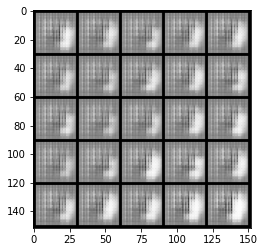

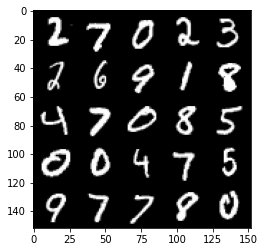

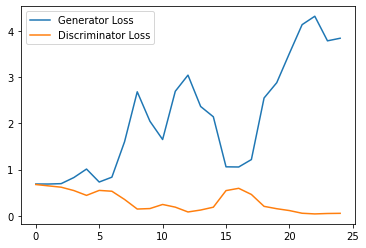

Step 1000: Generator loss: 3.627114177942276, discriminator loss: 0.1081925142519176


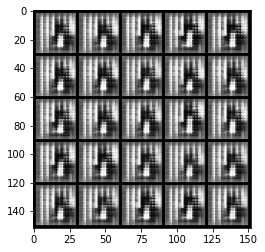

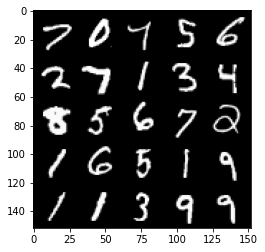

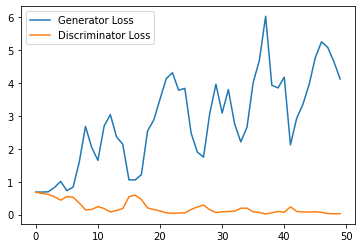

Step 1500: Generator loss: 3.7999321174621583, discriminator loss: 0.08138690797239542


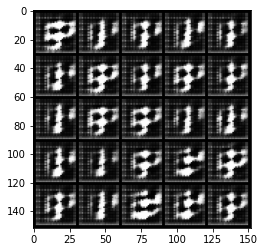

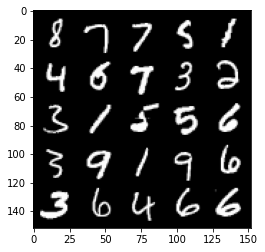

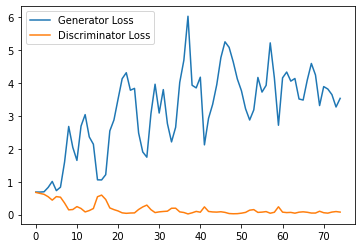

Step 2000: Generator loss: 3.868538607120514, discriminator loss: 0.0957623070962727


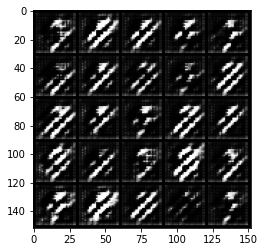

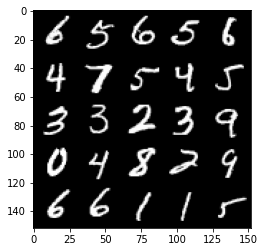

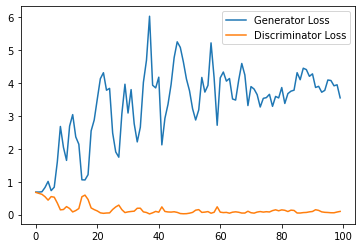

Step 2500: Generator loss: 3.1470434348583223, discriminator loss: 0.16757665070146321


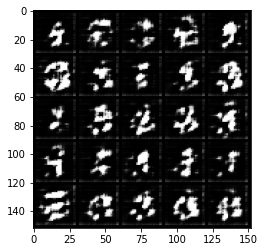

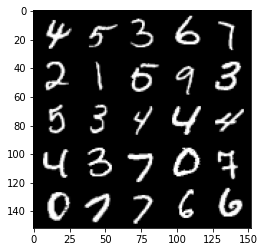

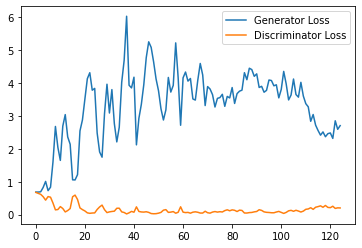

Step 3000: Generator loss: 2.4313727478981018, discriminator loss: 0.31277791967988017


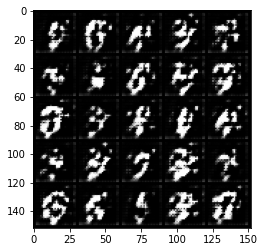

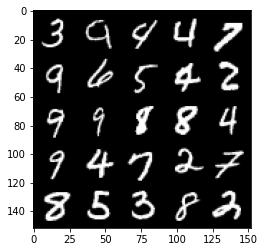

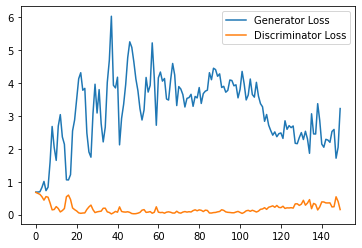

Step 3500: Generator loss: 2.0387290823459625, discriminator loss: 0.34488479840755465


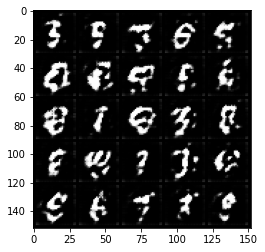

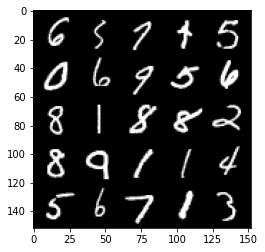

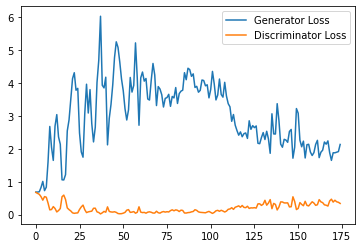

Step 4000: Generator loss: 1.8385142612457275, discriminator loss: 0.3610067057907581


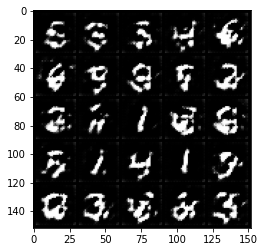

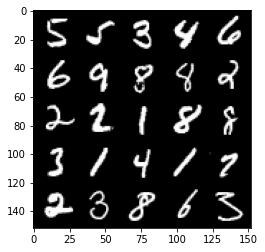

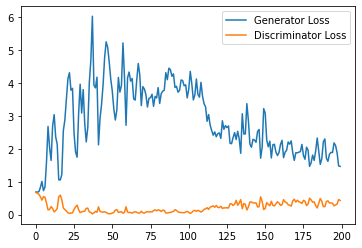

Step 4500: Generator loss: 1.9382815378904343, discriminator loss: 0.35306005838513377


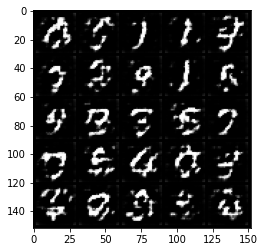

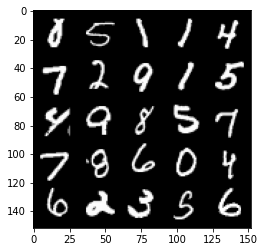

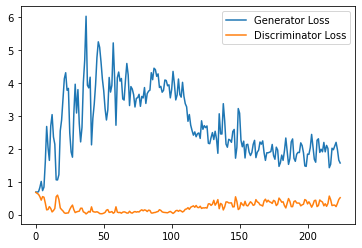

Step 5000: Generator loss: 1.9926261551380158, discriminator loss: 0.3298031379580498


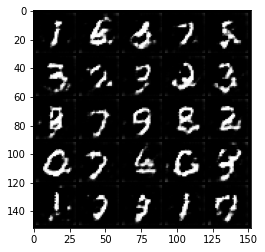

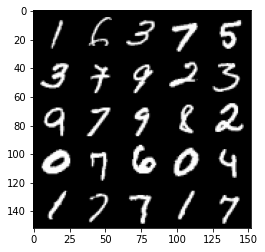

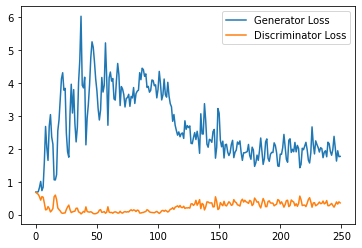

Step 5500: Generator loss: 1.9549568464756013, discriminator loss: 0.35450413334369657


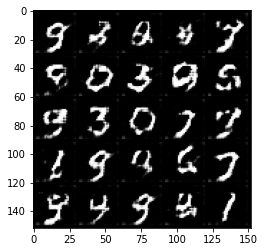

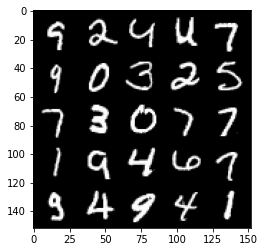

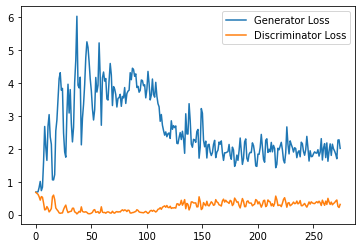

Step 6000: Generator loss: 1.7293810715675355, discriminator loss: 0.3778448701798916


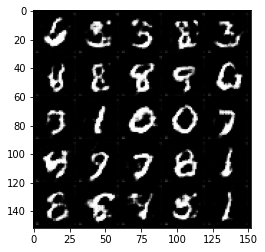

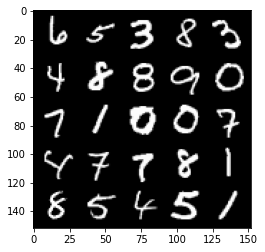

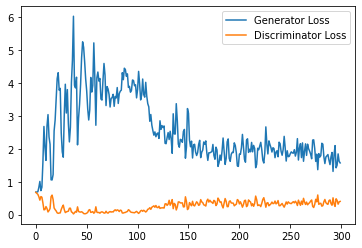

Step 6500: Generator loss: 1.7577514114379882, discriminator loss: 0.3984621403813362


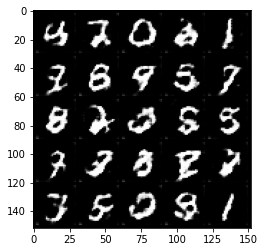

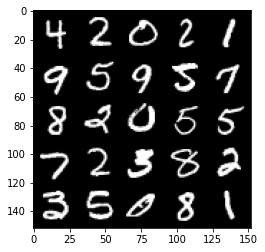

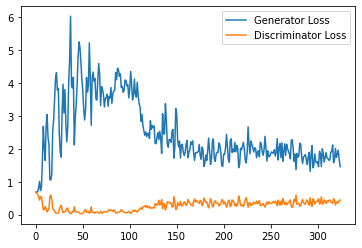

Step 7000: Generator loss: 1.6892423028945922, discriminator loss: 0.40135555747151375


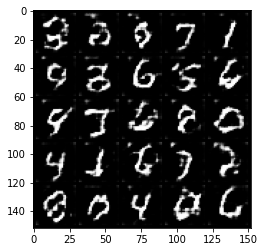

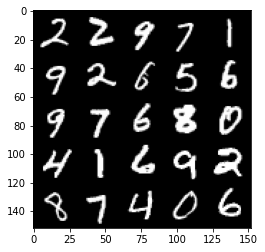

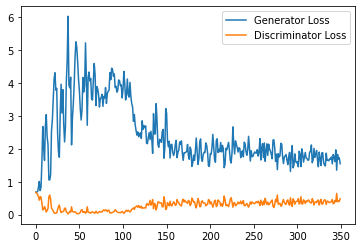

Step 7500: Generator loss: 1.656404246211052, discriminator loss: 0.42804614248871803


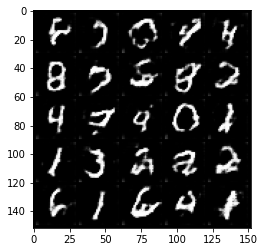

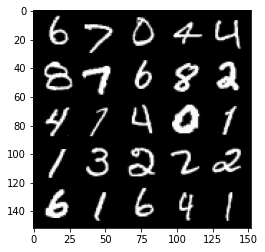

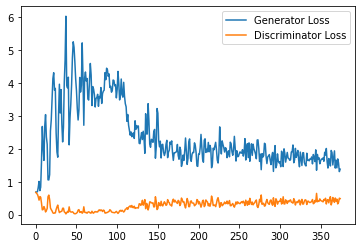

Step 8000: Generator loss: 1.5154168201684952, discriminator loss: 0.45245840346813204


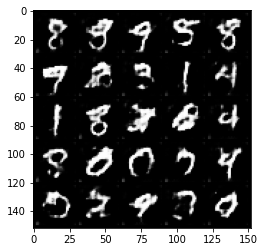

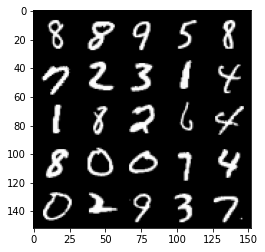

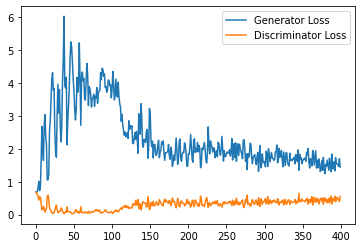

Step 8500: Generator loss: 1.481062400341034, discriminator loss: 0.47136176019907


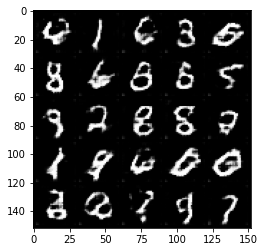

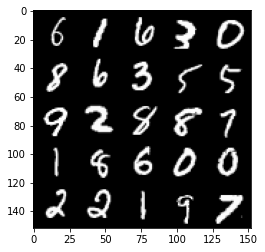

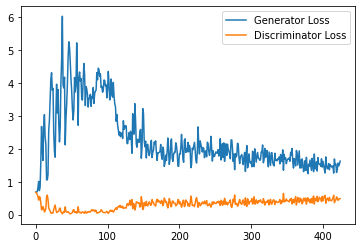

Step 9000: Generator loss: 1.4716761680841446, discriminator loss: 0.47967809891700747


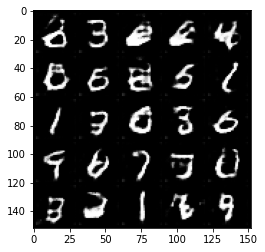

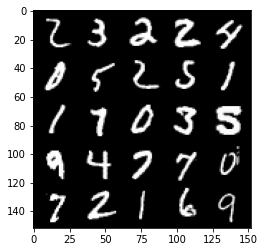

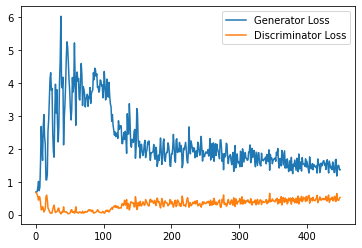

Step 9500: Generator loss: 1.41301755964756, discriminator loss: 0.48722906041145325


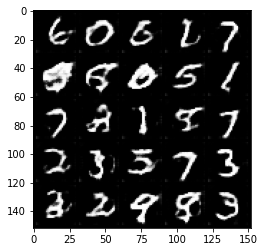

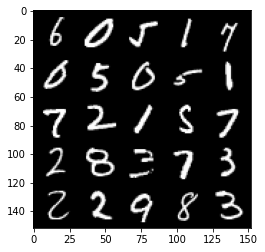

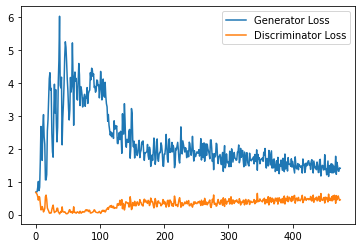

Step 10000: Generator loss: 1.3428976858854293, discriminator loss: 0.5093501781225205


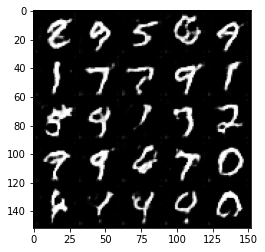

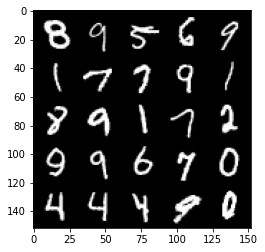

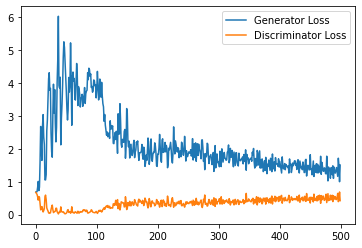

Step 10500: Generator loss: 1.2952822996377944, discriminator loss: 0.5169082061648369


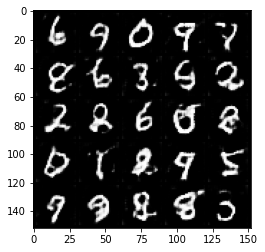

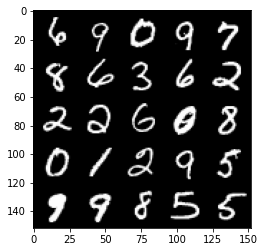

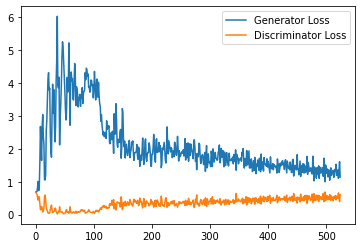

Step 11000: Generator loss: 1.327554909467697, discriminator loss: 0.5130580593347549


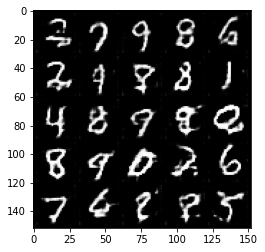

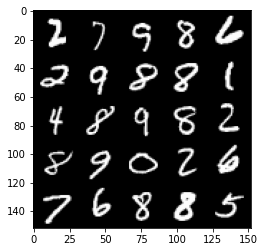

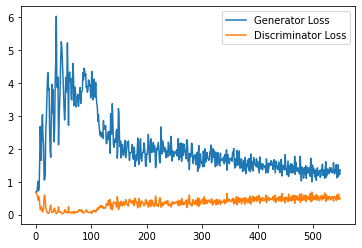

Step 11500: Generator loss: 1.31196930372715, discriminator loss: 0.5256149998307228


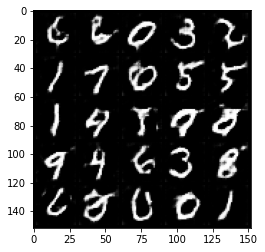

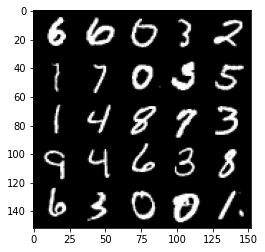

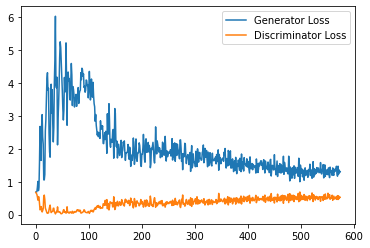

Step 12000: Generator loss: 1.2347840416431426, discriminator loss: 0.5266592649817466


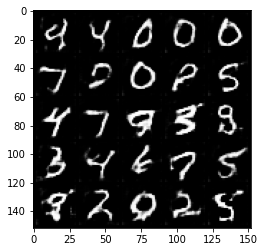

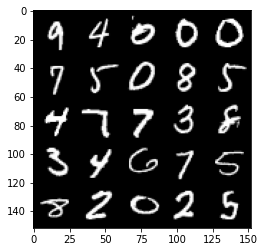

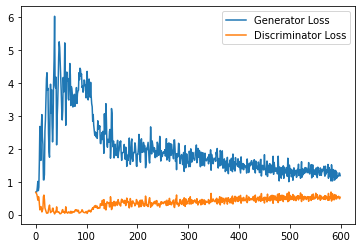

Step 12500: Generator loss: 1.2084758659601211, discriminator loss: 0.5388848356604576


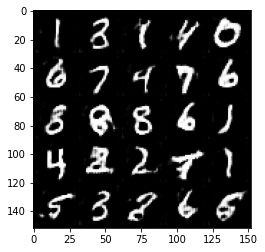

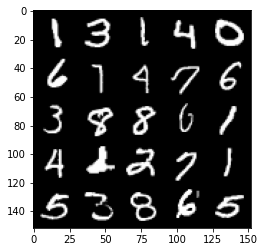

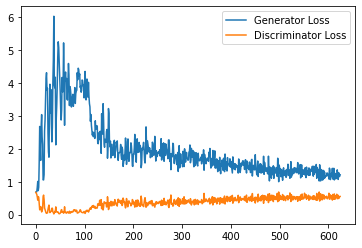

Step 13000: Generator loss: 1.2225471680164337, discriminator loss: 0.5430589284896851


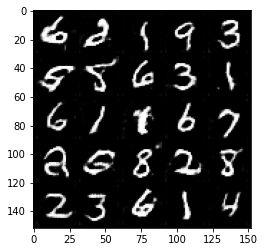

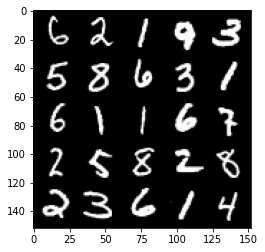

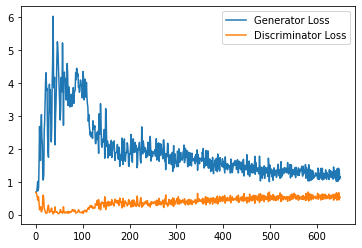

Step 13500: Generator loss: 1.1547927893400192, discriminator loss: 0.5431684837937355


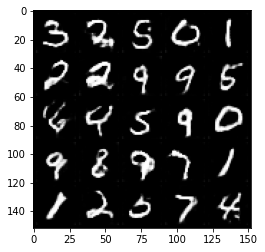

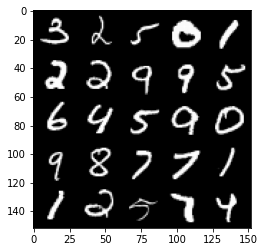

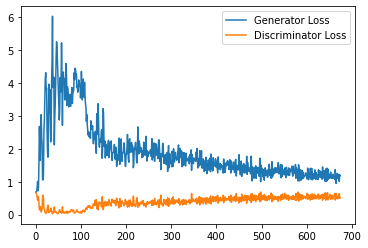

Step 14000: Generator loss: 1.1410449615716933, discriminator loss: 0.5572634279727936


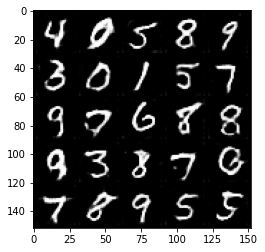

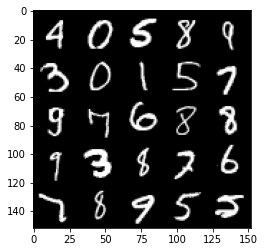

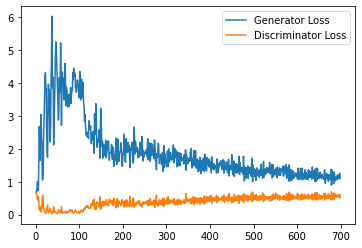

Step 14500: Generator loss: 1.1433819663524627, discriminator loss: 0.559304279088974


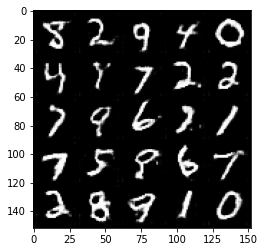

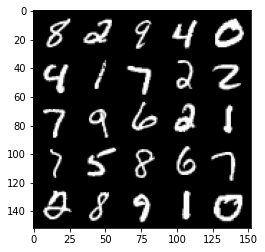

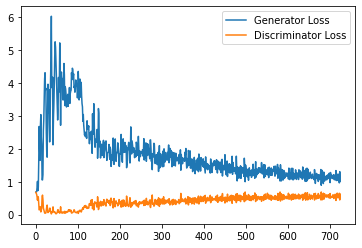

Step 15000: Generator loss: 1.1097662669420243, discriminator loss: 0.5607941514849663


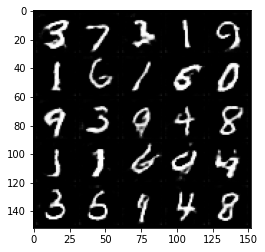

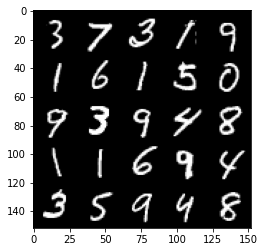

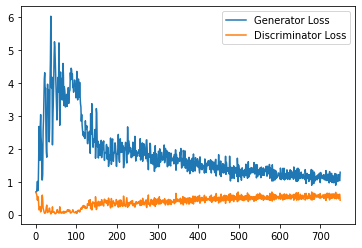

Step 15500: Generator loss: 1.117453290104866, discriminator loss: 0.5660603147745132


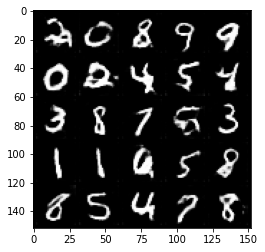

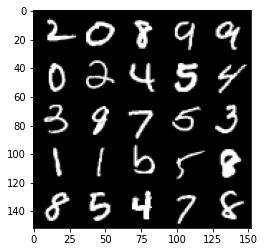

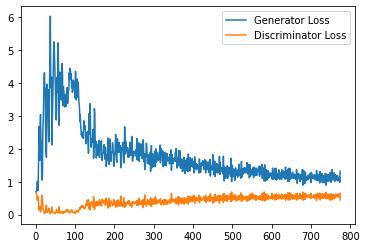

Step 16000: Generator loss: 1.0968586311340331, discriminator loss: 0.5729377725124359


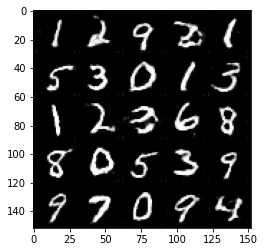

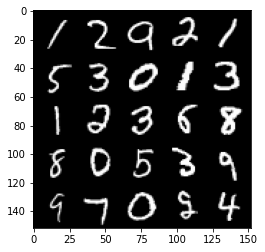

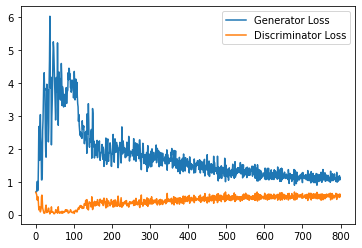

Step 16500: Generator loss: 1.1184863407611847, discriminator loss: 0.5729155891537666


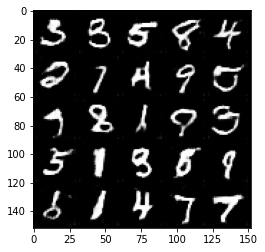

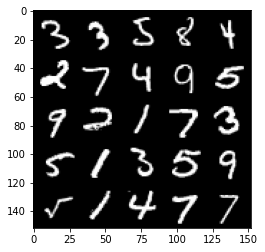

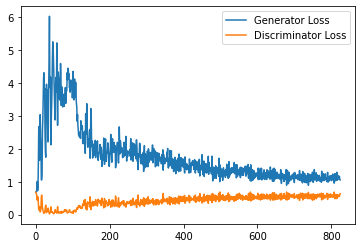

Step 17000: Generator loss: 1.0739540795087814, discriminator loss: 0.5745195358991623


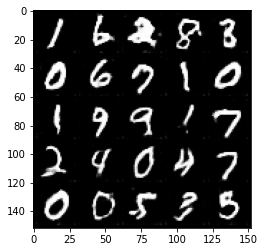

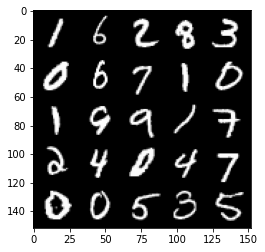

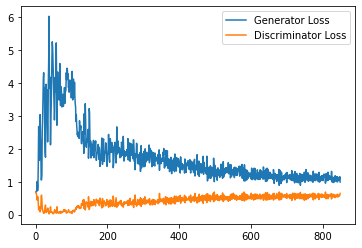

Step 17500: Generator loss: 1.0583447042703629, discriminator loss: 0.5746751779913902


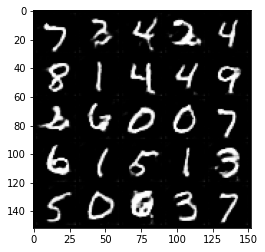

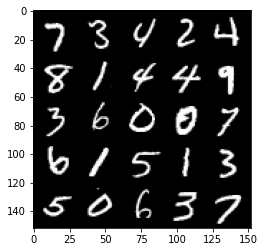

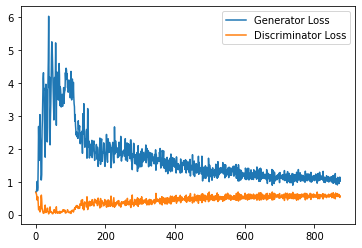

Step 18000: Generator loss: 1.0600162703990936, discriminator loss: 0.5884523647427559


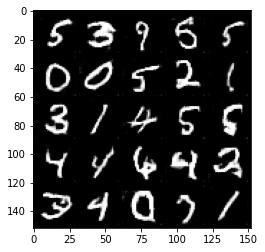

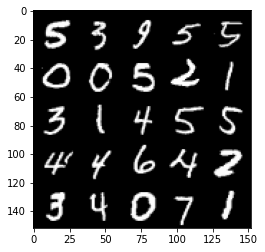

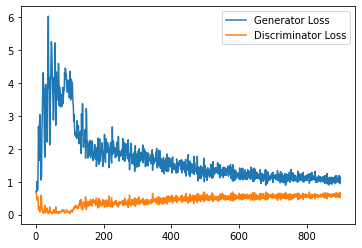

Step 18500: Generator loss: 1.0780578097105027, discriminator loss: 0.5852792977094651


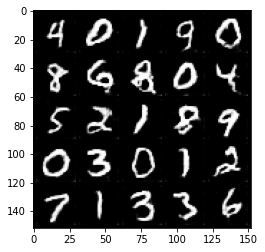

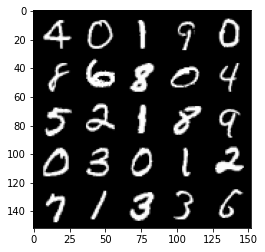

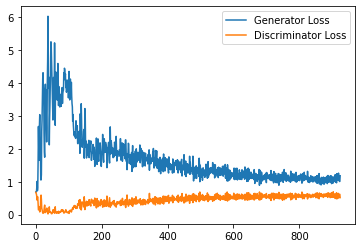

Step 19000: Generator loss: 1.0714318512678147, discriminator loss: 0.5878881883621215


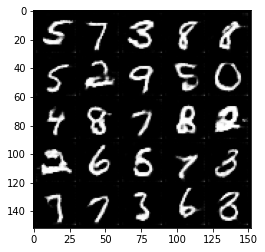

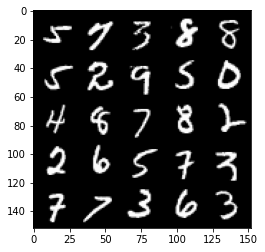

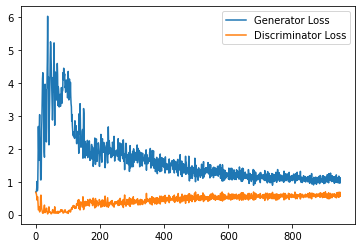

Step 19500: Generator loss: 1.054193503499031, discriminator loss: 0.5855744890570641


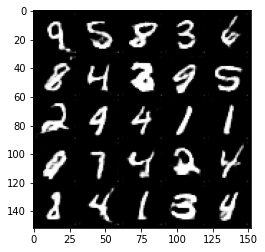

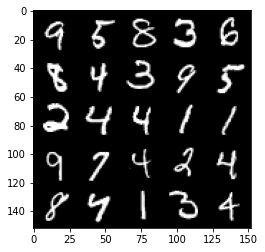

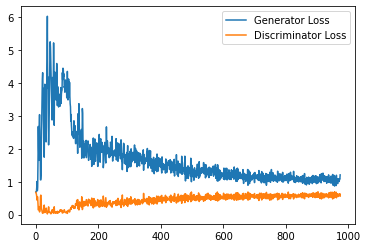

Step 20000: Generator loss: 1.0502897921800614, discriminator loss: 0.5947255727648735


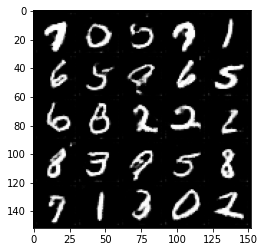

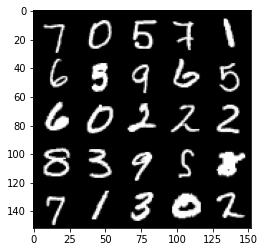

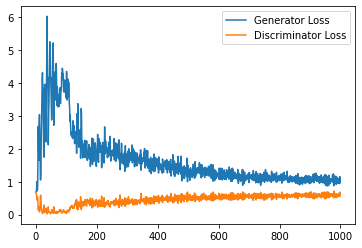

Step 20500: Generator loss: 1.0630209412574767, discriminator loss: 0.5901363148093224


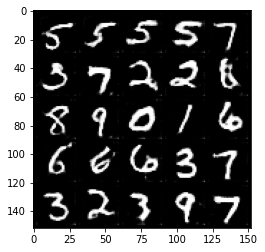

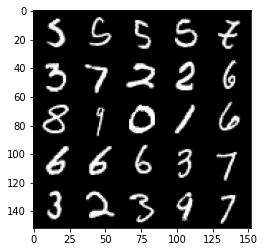

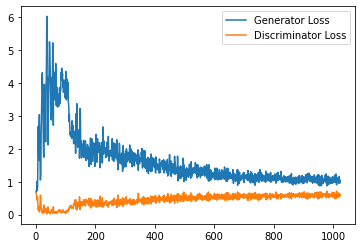

Step 21000: Generator loss: 1.0282287294864654, discriminator loss: 0.5890227325558662


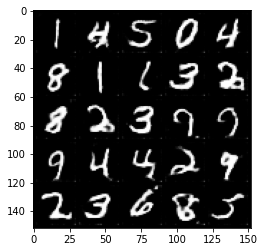

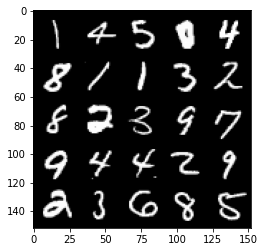

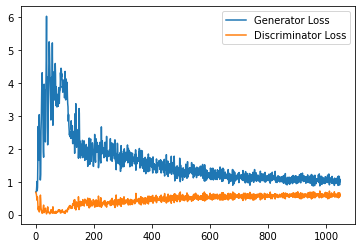

Step 21500: Generator loss: 1.0223376486301423, discriminator loss: 0.5904042339324951


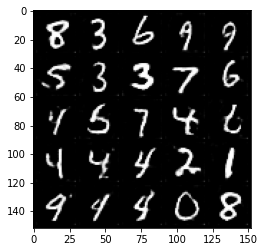

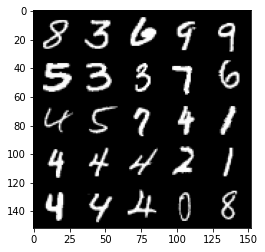

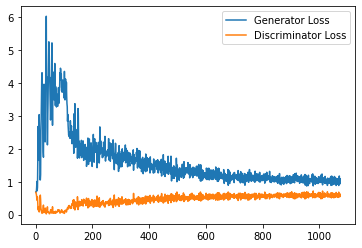

Step 22000: Generator loss: 1.0152203971147538, discriminator loss: 0.5915418846011162


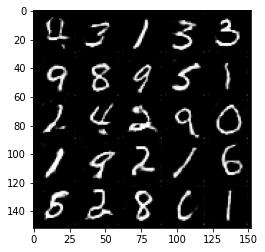

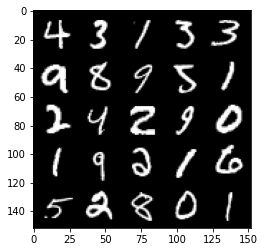

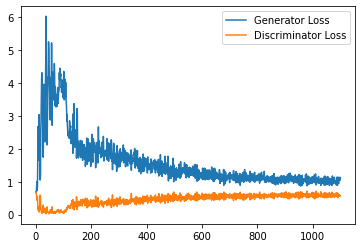

Step 22500: Generator loss: 1.035686415553093, discriminator loss: 0.6002474046945572


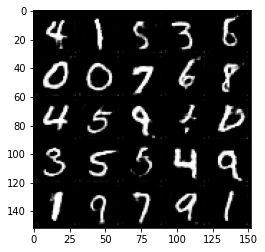

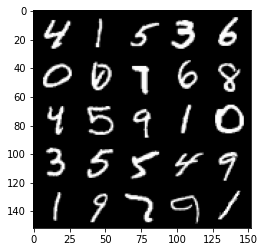

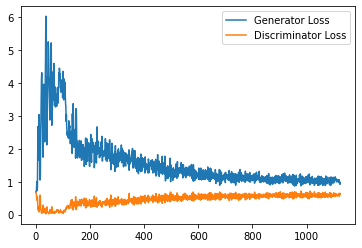

Step 23000: Generator loss: 1.0294627504348755, discriminator loss: 0.5951354306340217


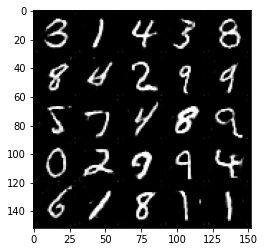

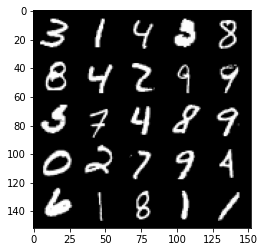

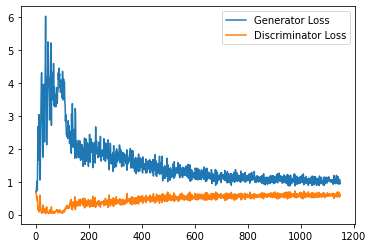

Step 23500: Generator loss: 0.9978099076747894, discriminator loss: 0.5994505472779273


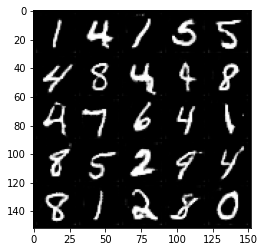

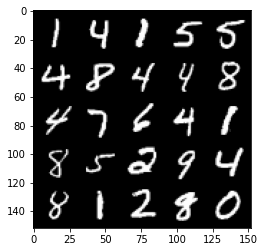

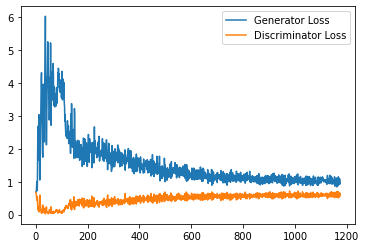

Step 24000: Generator loss: 1.0226896535158156, discriminator loss: 0.5957413064837456


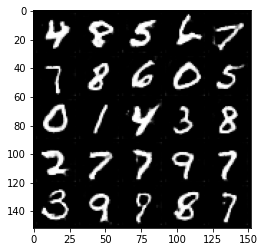

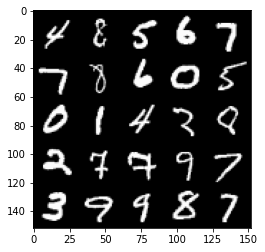

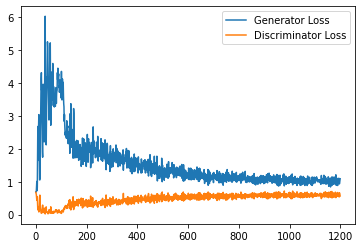

Step 24500: Generator loss: 1.0095612493753434, discriminator loss: 0.59828711861372


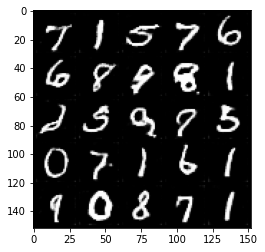

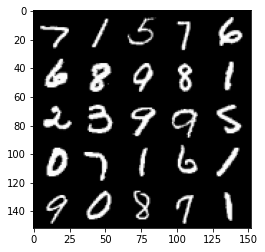

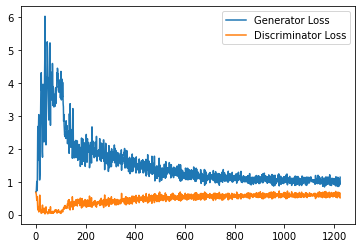

Step 25000: Generator loss: 1.0095015064477921, discriminator loss: 0.6051708889603615


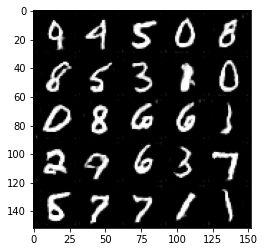

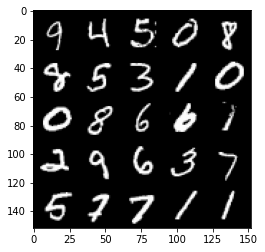

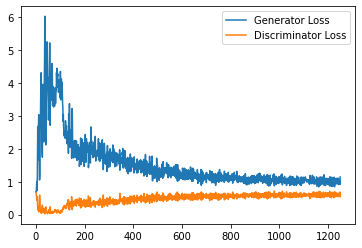

Step 25500: Generator loss: 0.995599568605423, discriminator loss: 0.6021590631604194


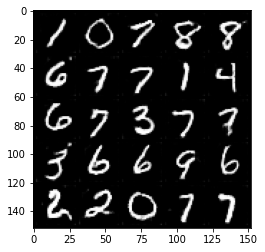

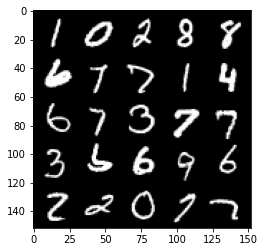

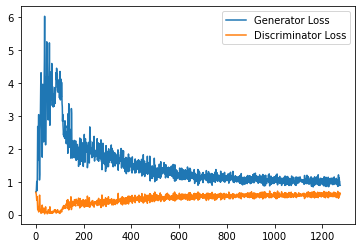

Step 26000: Generator loss: 0.975938319683075, discriminator loss: 0.6028327288627624


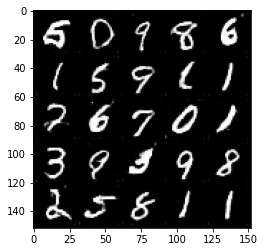

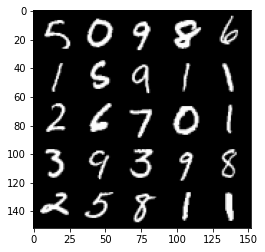

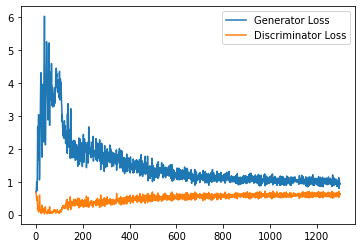

Step 26500: Generator loss: 1.0080765120983124, discriminator loss: 0.6019627056717872


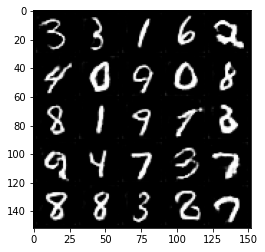

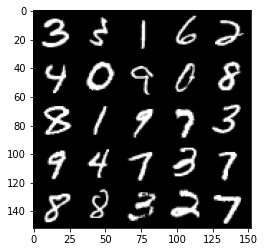

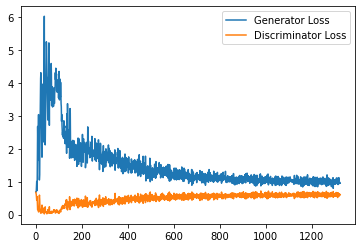

Step 27000: Generator loss: 0.9780476874113083, discriminator loss: 0.601406439602375


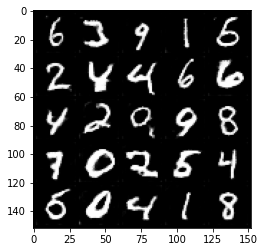

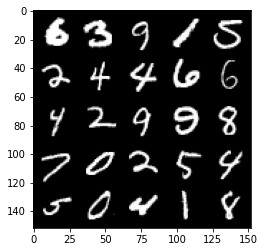

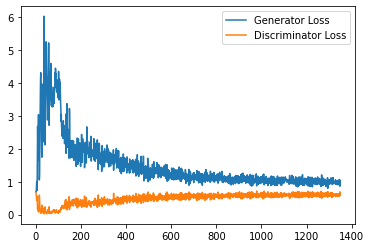

Step 27500: Generator loss: 0.9966117328405381, discriminator loss: 0.6018464531898499


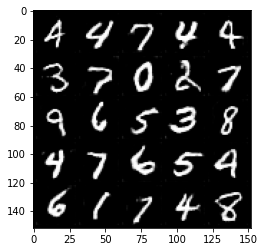

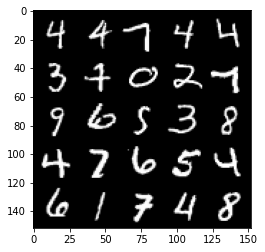

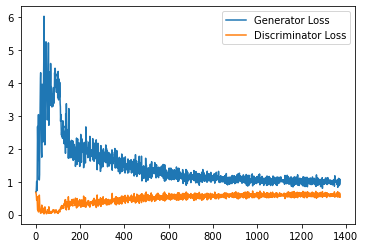

Step 28000: Generator loss: 0.9959930727481842, discriminator loss: 0.6058495272994041


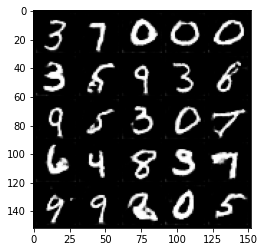

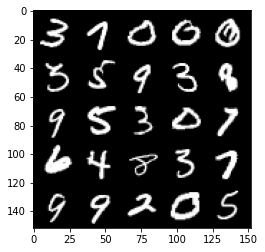

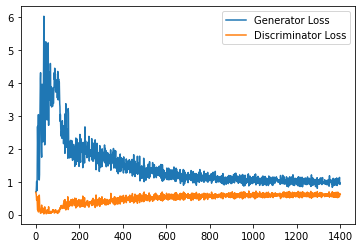

Step 28500: Generator loss: 0.9988278245925903, discriminator loss: 0.6064811059832573


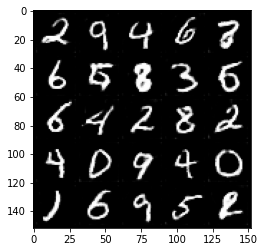

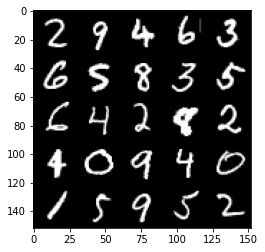

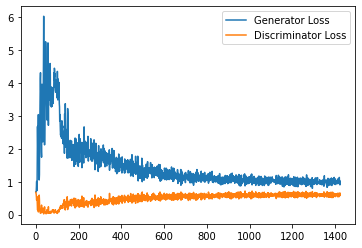

Step 29000: Generator loss: 1.0004798921346665, discriminator loss: 0.6065584381222725


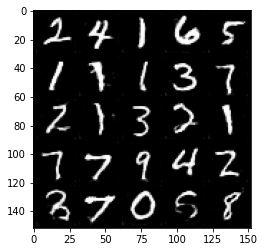

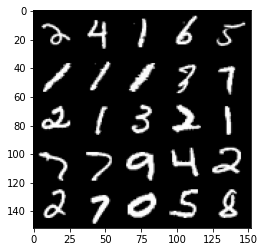

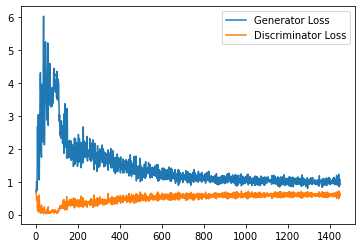

Step 29500: Generator loss: 0.9762338800430298, discriminator loss: 0.6029612525701523


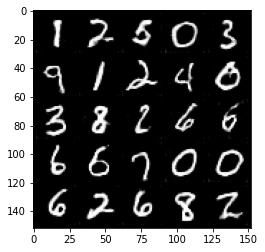

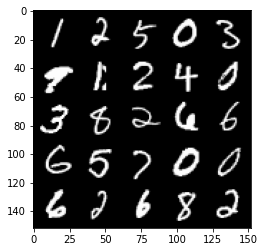

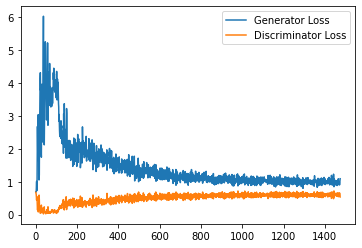

Step 30000: Generator loss: 0.9669392693042755, discriminator loss: 0.6116510002017022


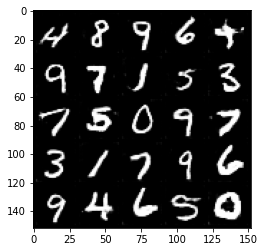

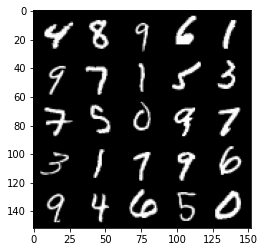

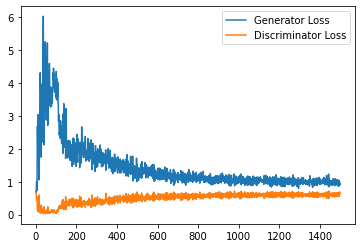

Step 30500: Generator loss: 0.9881670347452164, discriminator loss: 0.6020808409452438


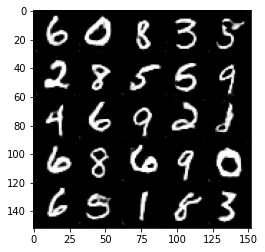

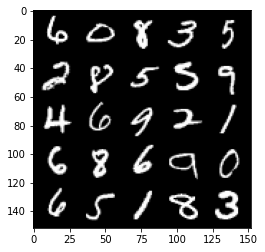

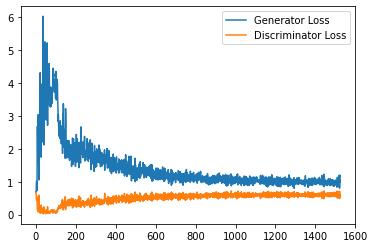

Step 31000: Generator loss: 0.9792667987346649, discriminator loss: 0.6065774196982384


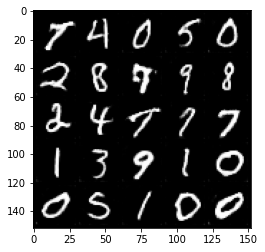

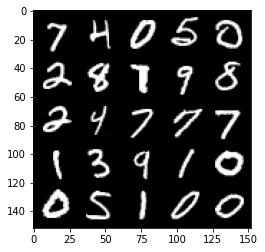

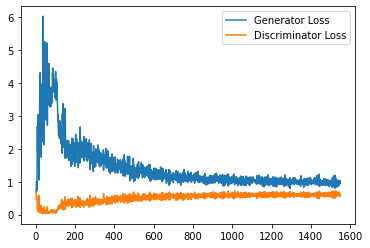

Step 31500: Generator loss: 0.9682864305973053, discriminator loss: 0.6119652741551399


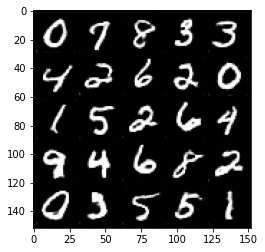

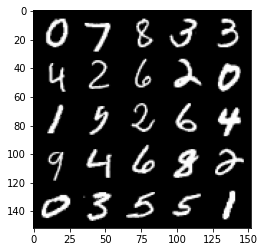

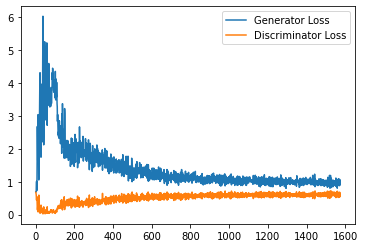

Step 32000: Generator loss: 0.9688023166656494, discriminator loss: 0.6074832643866539


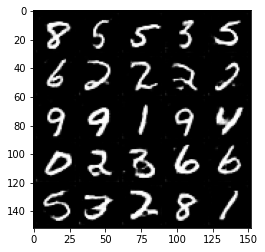

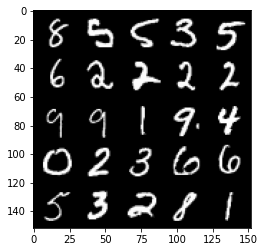

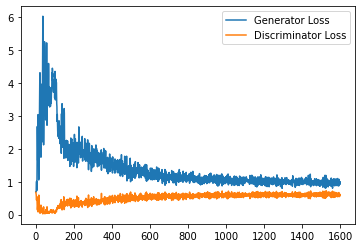

Step 32500: Generator loss: 0.9647422703504562, discriminator loss: 0.616482439160347


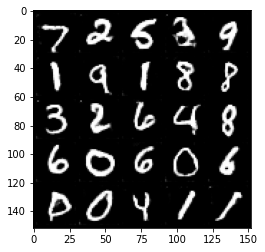

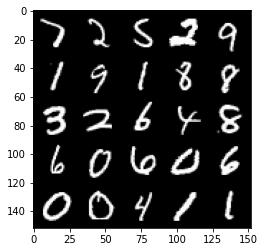

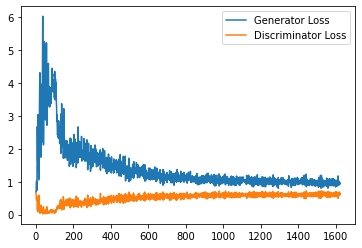

Step 33000: Generator loss: 0.9713862453699111, discriminator loss: 0.6129723497629166


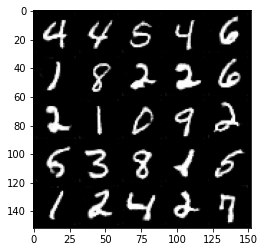

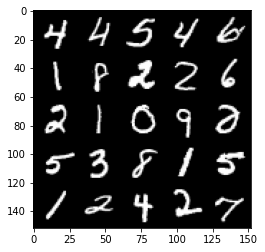

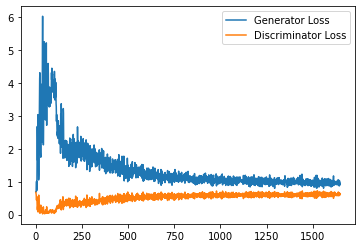

Step 33500: Generator loss: 0.9707999012470245, discriminator loss: 0.6116603060960769


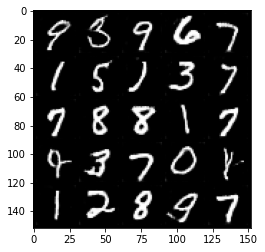

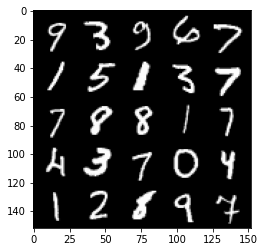

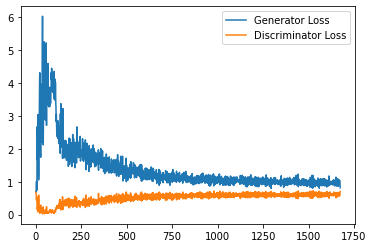

Step 34000: Generator loss: 0.9711262514591217, discriminator loss: 0.6110885999798775


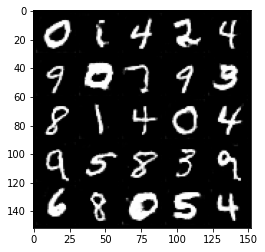

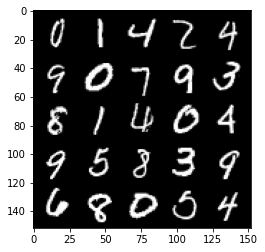

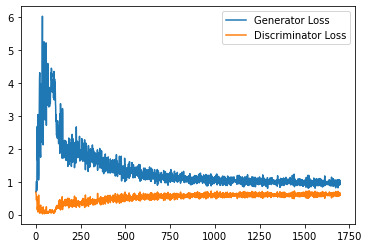

Step 34500: Generator loss: 0.9874035685062409, discriminator loss: 0.610357529103756


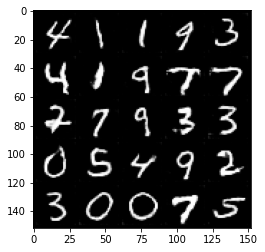

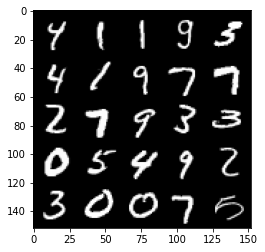

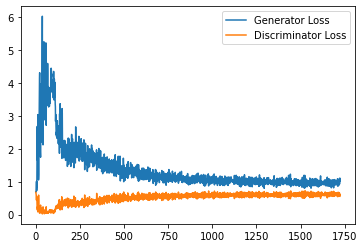

Step 35000: Generator loss: 0.958628185749054, discriminator loss: 0.621951026916504


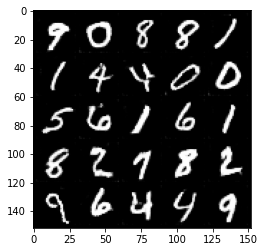

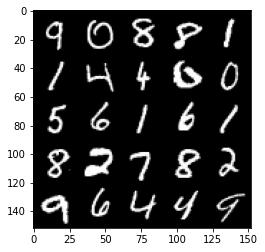

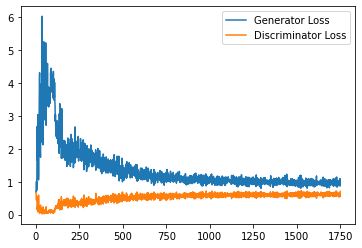

Step 35500: Generator loss: 0.9541651419401169, discriminator loss: 0.6108836696147919


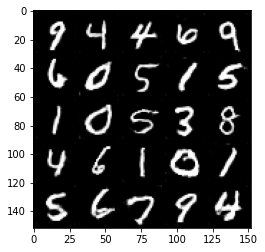

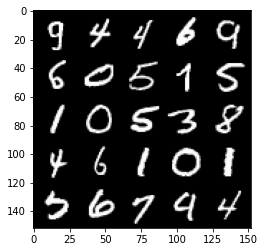

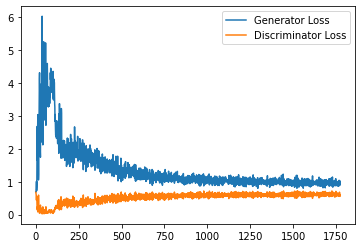

Step 36000: Generator loss: 0.9660251047611237, discriminator loss: 0.6110152313113213


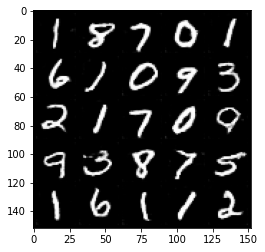

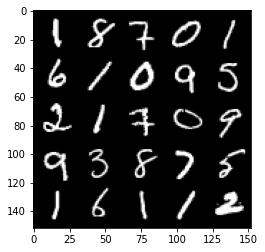

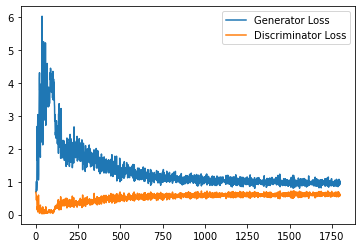

Step 36500: Generator loss: 0.9694473975896836, discriminator loss: 0.6118107935786248


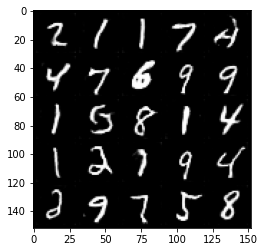

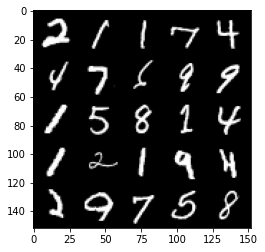

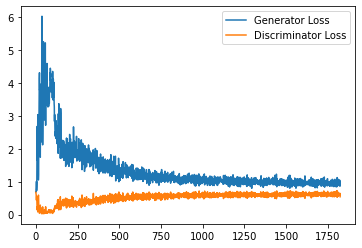

Step 37000: Generator loss: 0.9544775612354278, discriminator loss: 0.6084802989959717


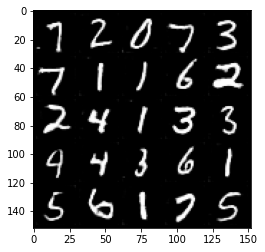

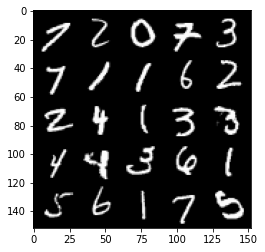

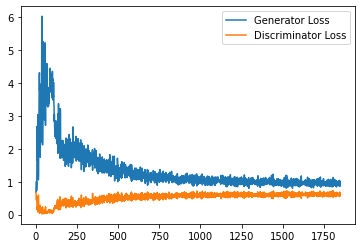

Step 37500: Generator loss: 0.9486373730897903, discriminator loss: 0.6138472930788994


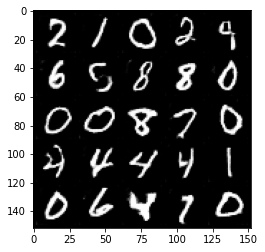

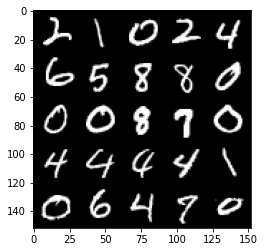

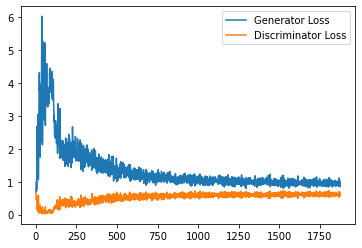

Step 38000: Generator loss: 0.9811129659414292, discriminator loss: 0.6080727913975715


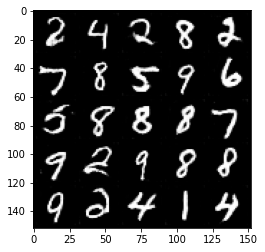

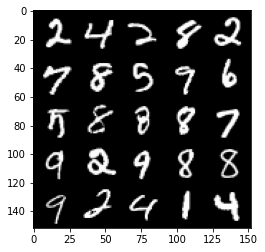

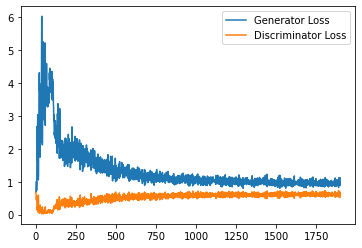

Step 38500: Generator loss: 0.9575945496559143, discriminator loss: 0.6149102956056595


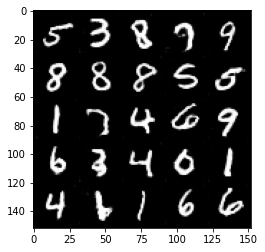

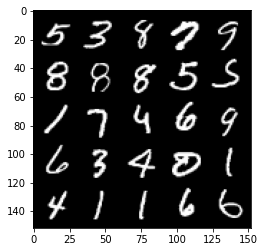

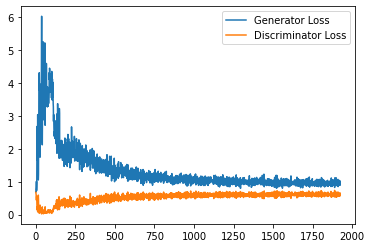

Step 39000: Generator loss: 0.958218910574913, discriminator loss: 0.6100802966952323


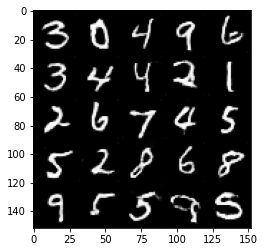

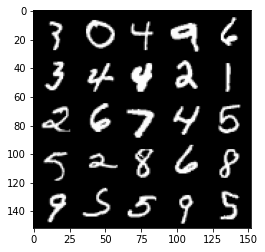

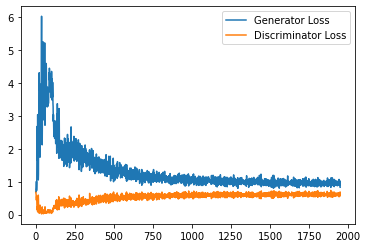

Step 39500: Generator loss: 0.9277670867443085, discriminator loss: 0.6152129901051522


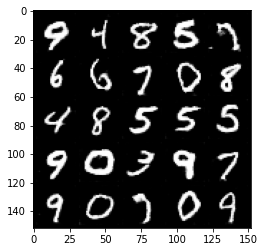

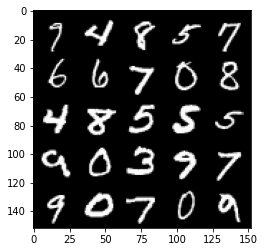

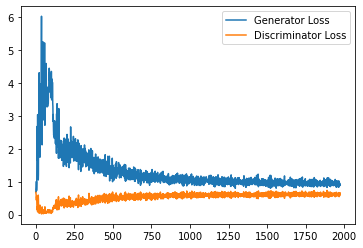

Step 40000: Generator loss: 0.9669980106353759, discriminator loss: 0.6074560685753823


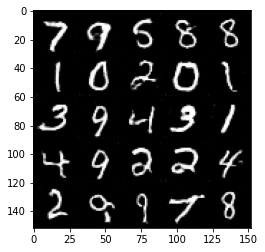

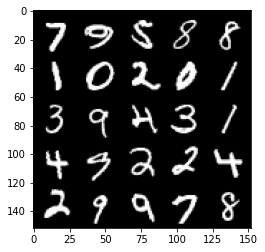

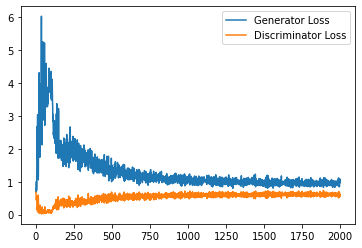

Step 40500: Generator loss: 0.9517989966869355, discriminator loss: 0.6140659891366959


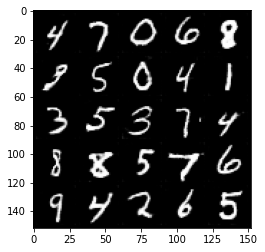

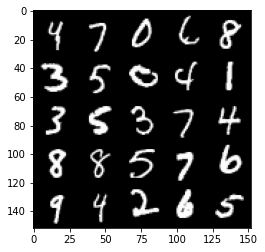

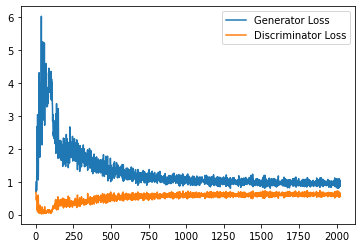

Step 41000: Generator loss: 0.9551563047170639, discriminator loss: 0.6091154113411903


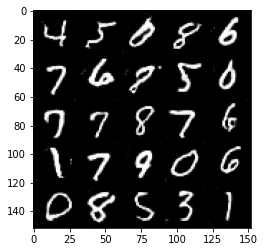

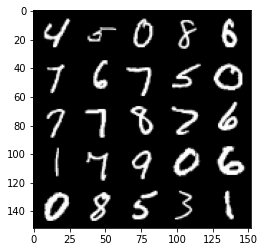

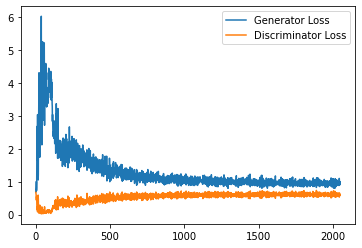

Step 41500: Generator loss: 0.9518777406215668, discriminator loss: 0.6132862695455551


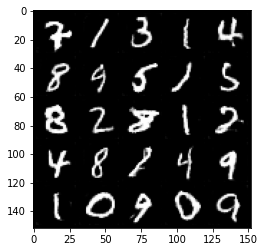

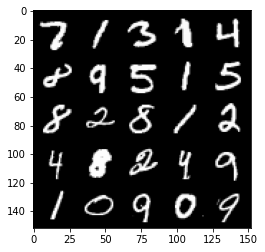

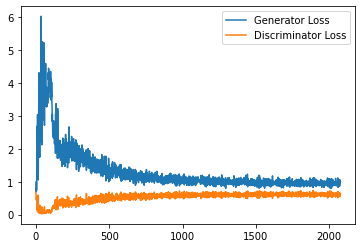

Step 42000: Generator loss: 0.9446704938411713, discriminator loss: 0.6079265081882477


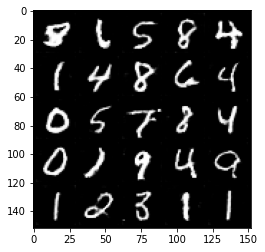

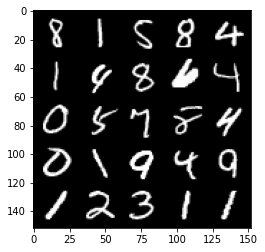

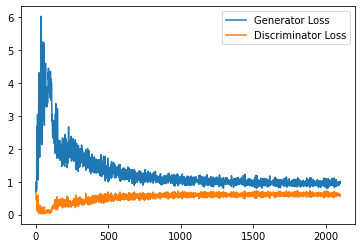

Step 42500: Generator loss: 0.9751849076747894, discriminator loss: 0.6146694565415383


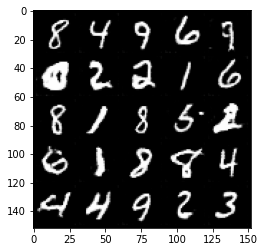

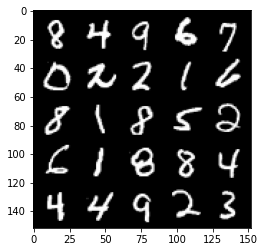

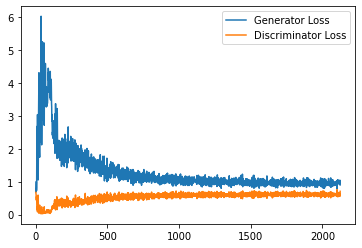

Step 43000: Generator loss: 0.9597606542110443, discriminator loss: 0.6076241011023521


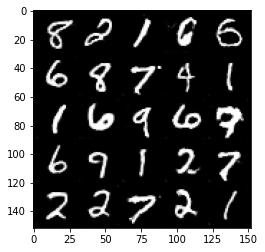

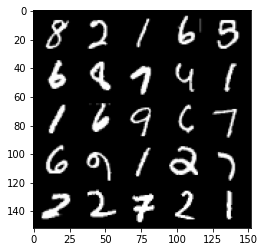

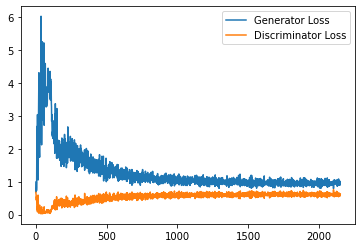

Step 43500: Generator loss: 0.9618814064264297, discriminator loss: 0.6059302573800087


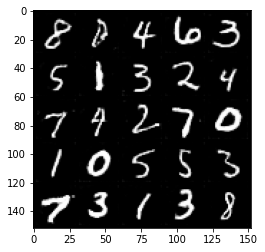

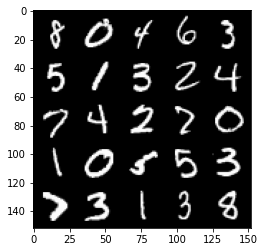

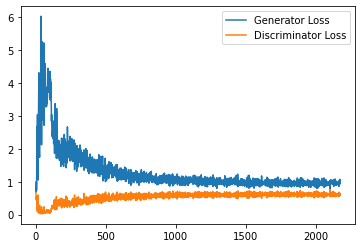

Step 44000: Generator loss: 0.9558020619153976, discriminator loss: 0.6140321286916732


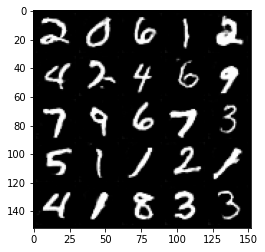

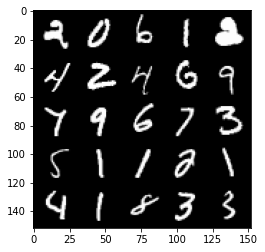

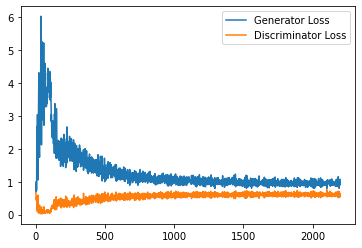

Step 44500: Generator loss: 0.9493374345302582, discriminator loss: 0.618100323677063


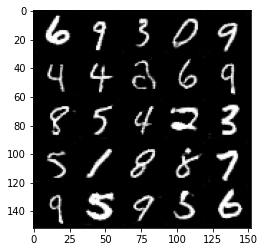

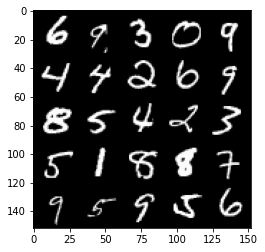

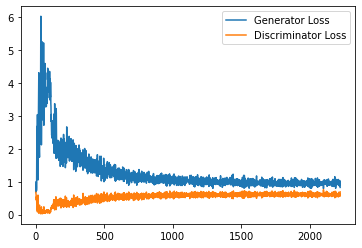

Step 45000: Generator loss: 0.953457674741745, discriminator loss: 0.6112669474482536


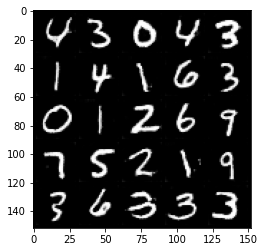

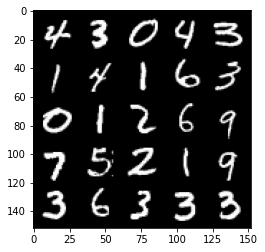

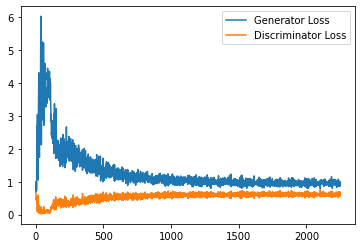

Step 45500: Generator loss: 0.9592583243846893, discriminator loss: 0.6110621548891068


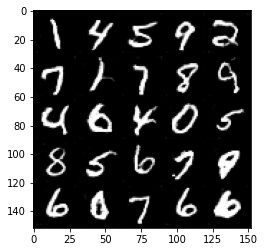

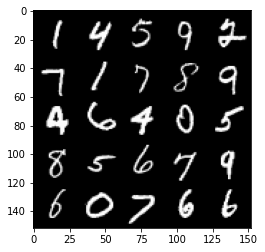

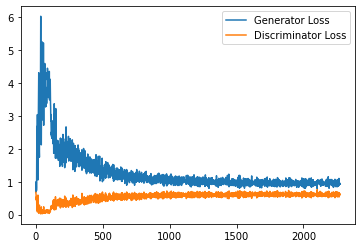

Step 46000: Generator loss: 0.9614574111700058, discriminator loss: 0.6103873915672302


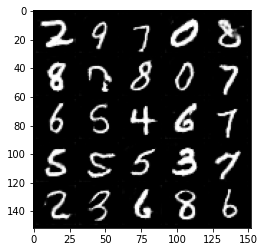

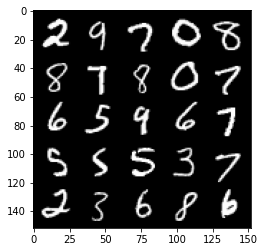

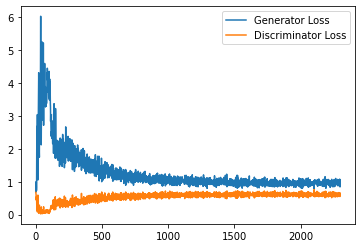

Step 46500: Generator loss: 0.9424853316545486, discriminator loss: 0.609080020070076


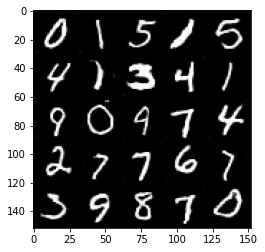

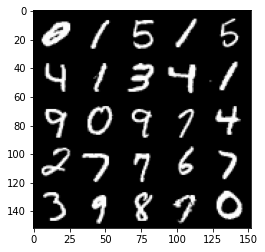

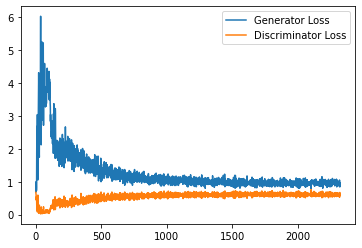

Step 47000: Generator loss: 0.9307507792711258, discriminator loss: 0.6121680660247802


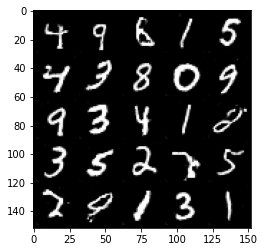

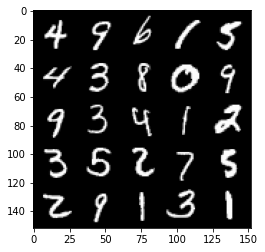

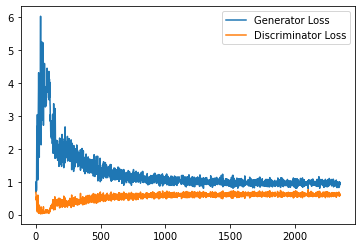

Step 47500: Generator loss: 0.9552351315021514, discriminator loss: 0.6107858494520187


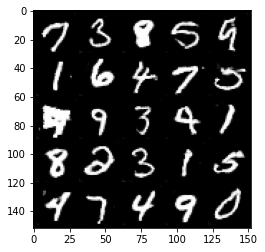

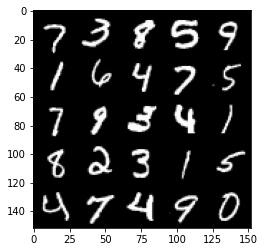

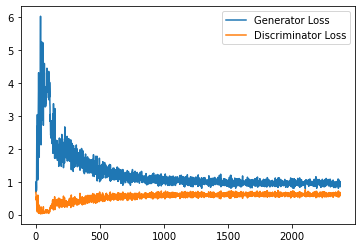

Step 48000: Generator loss: 0.9805817581415176, discriminator loss: 0.6067140772342682


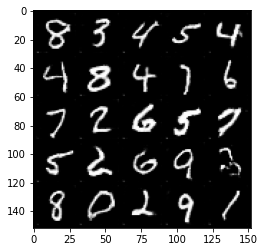

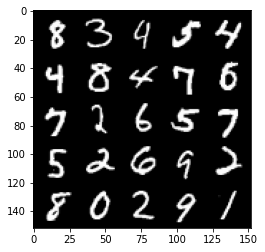

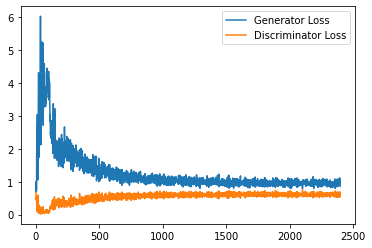

Step 48500: Generator loss: 0.9539744958877564, discriminator loss: 0.6094478576779365


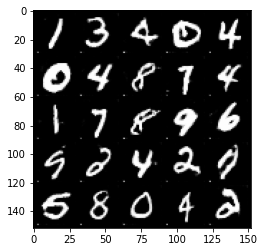

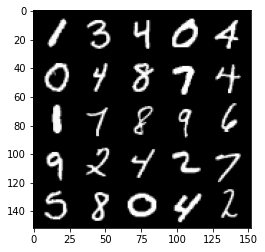

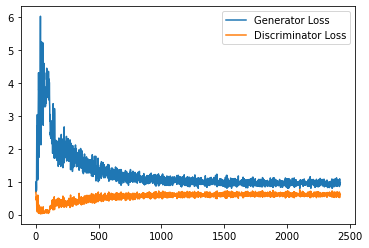

Step 49000: Generator loss: 0.9452493817806243, discriminator loss: 0.6095730512142181


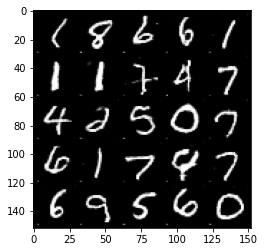

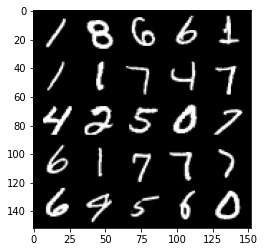

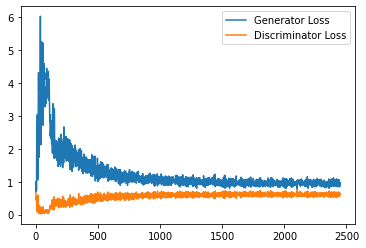

Step 49500: Generator loss: 0.9506442365646363, discriminator loss: 0.6044375135302543


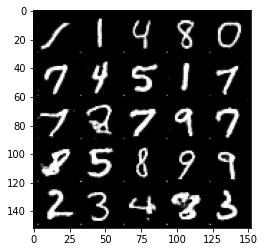

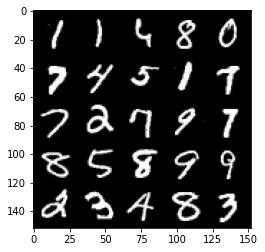

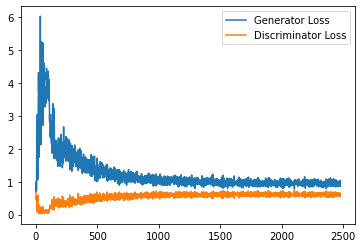

Step 50000: Generator loss: 0.9688760688304902, discriminator loss: 0.6080871260762215


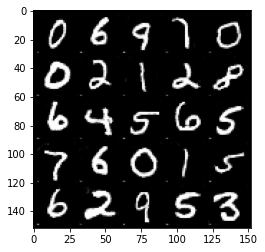

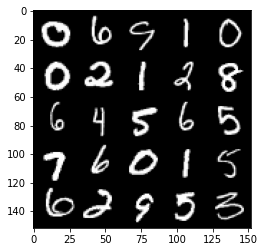

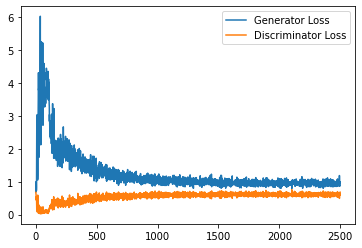

Step 50500: Generator loss: 0.9671299164295196, discriminator loss: 0.6043379213809967


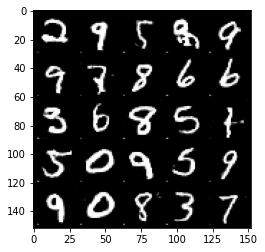

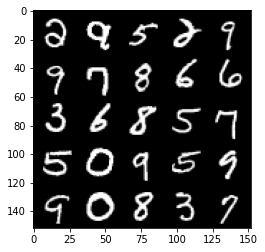

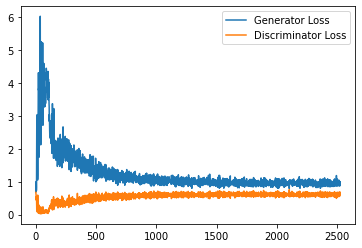

Step 51000: Generator loss: 0.9855780093669891, discriminator loss: 0.6051682968139649


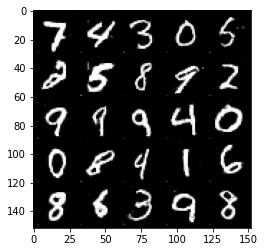

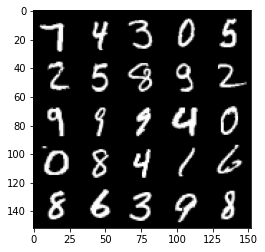

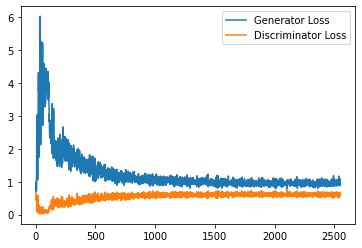

Step 51500: Generator loss: 0.9818452560901642, discriminator loss: 0.6015646630525588


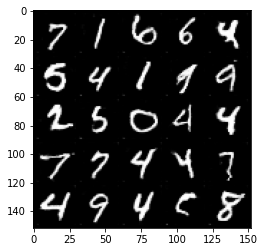

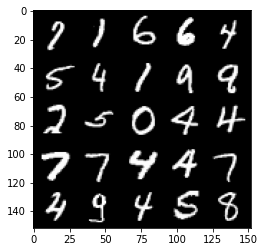

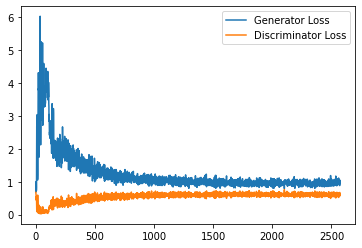

Step 52000: Generator loss: 0.9781478476524353, discriminator loss: 0.6059114683270455


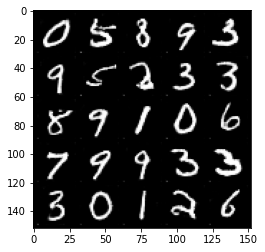

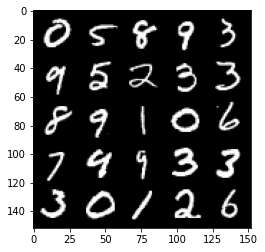

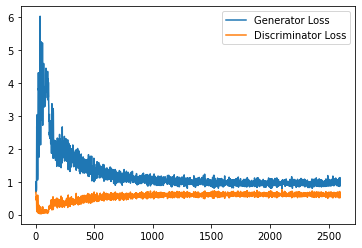

Step 52500: Generator loss: 0.95982672727108, discriminator loss: 0.602783048927784


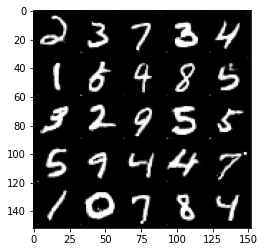

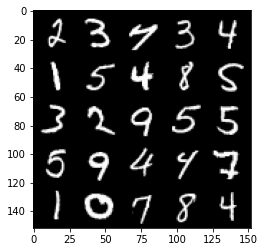

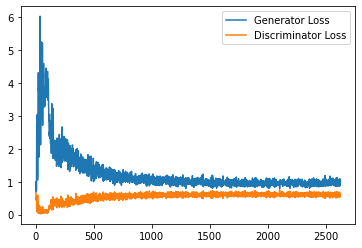

Step 53000: Generator loss: 0.9636153202056885, discriminator loss: 0.6048426350355148


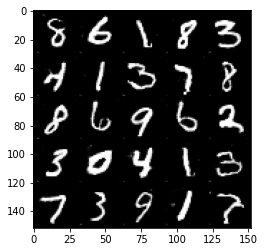

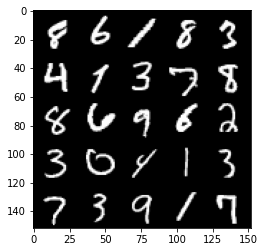

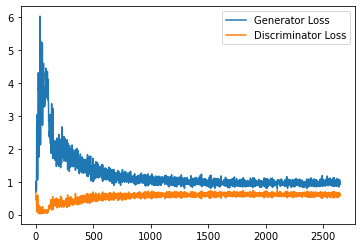

Step 53500: Generator loss: 0.9789545089006424, discriminator loss: 0.5954792310595513


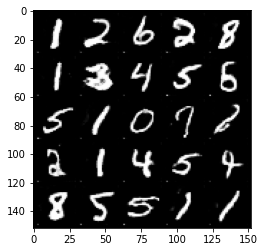

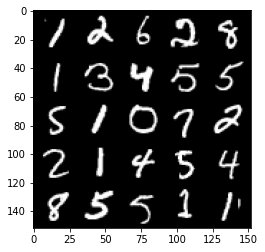

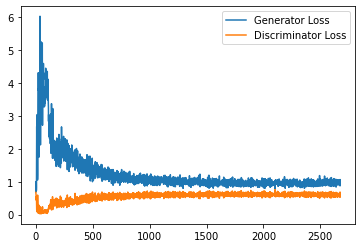

Step 54000: Generator loss: 0.9822620391845703, discriminator loss: 0.5985802604556084


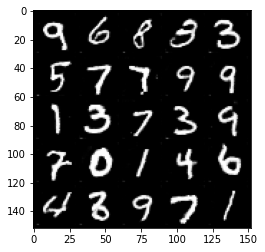

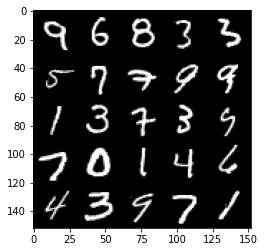

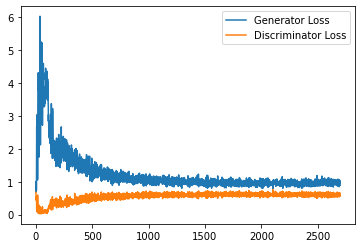

Step 54500: Generator loss: 0.9699960287809372, discriminator loss: 0.5979956263899803


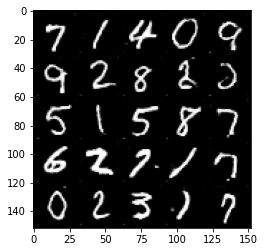

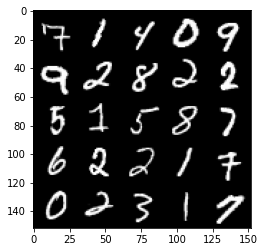

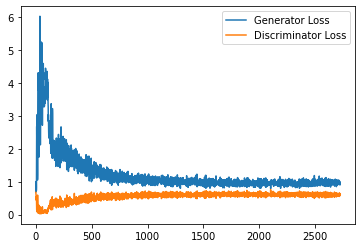

Step 55000: Generator loss: 0.9689762350320816, discriminator loss: 0.5957566282749176


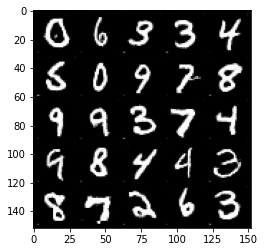

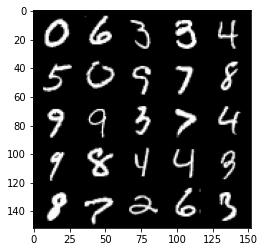

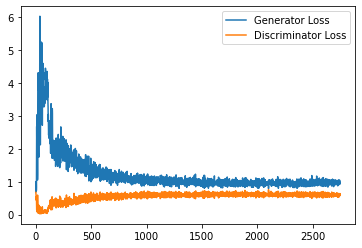

Step 55500: Generator loss: 0.968994149684906, discriminator loss: 0.5899091106057167


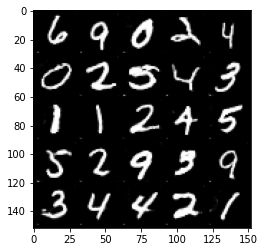

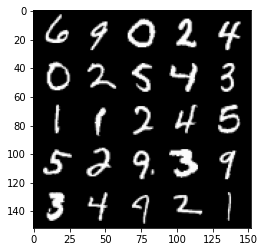

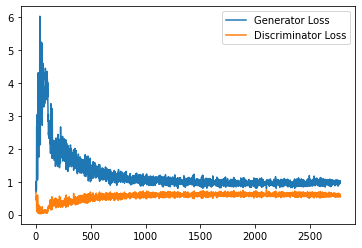

Step 56000: Generator loss: 0.9823649924993515, discriminator loss: 0.6006645980477333


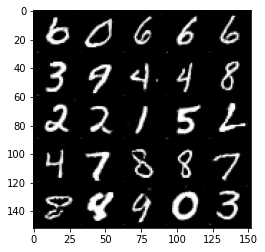

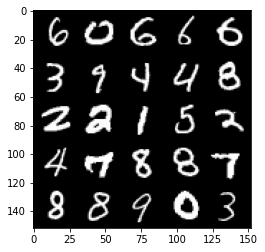

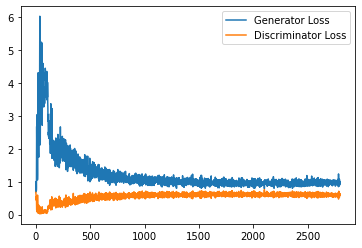

Step 56500: Generator loss: 0.976080379486084, discriminator loss: 0.5965549592375755


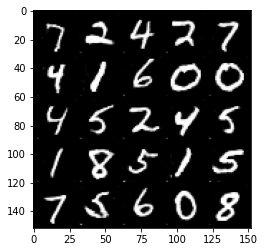

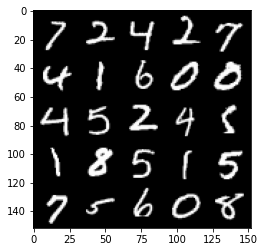

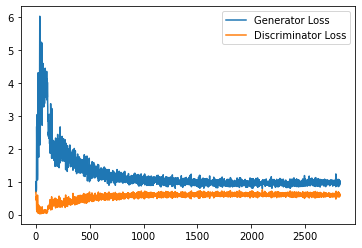

Step 57000: Generator loss: 1.0022133625745773, discriminator loss: 0.5888378692269325


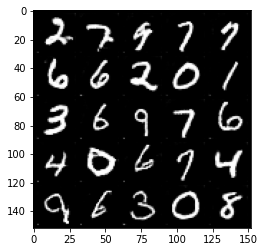

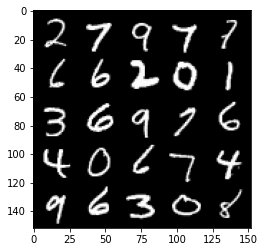

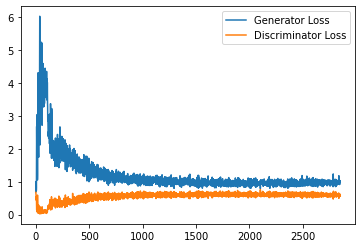

Step 57500: Generator loss: 0.9890974968671798, discriminator loss: 0.5941614646911622


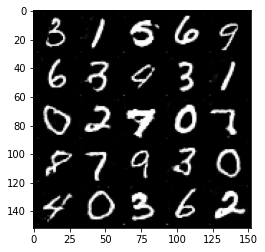

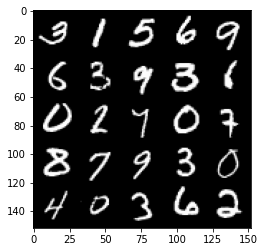

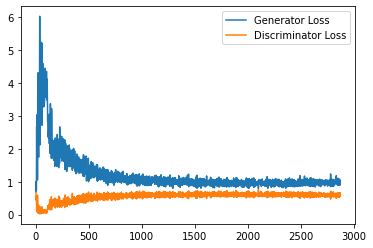

Step 58000: Generator loss: 1.0013148198127746, discriminator loss: 0.5891341981291771


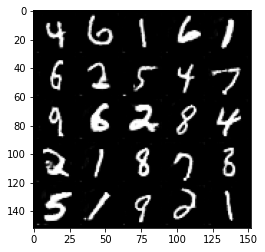

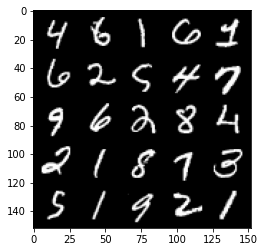

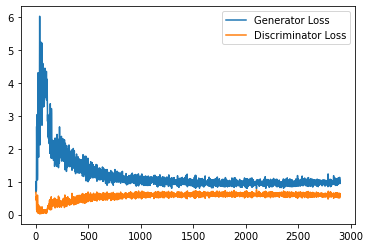

Step 58500: Generator loss: 0.9878095322847367, discriminator loss: 0.5902975572943687


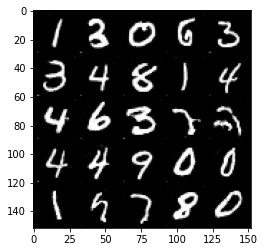

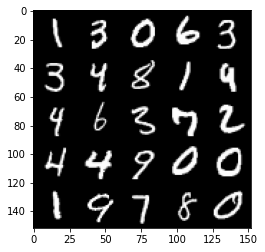

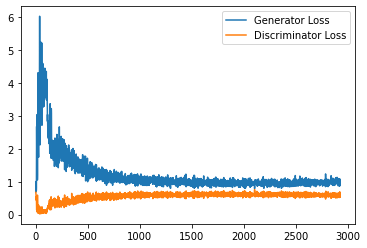

Step 59000: Generator loss: 1.0046960804462433, discriminator loss: 0.5927859268188477


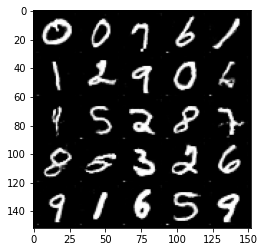

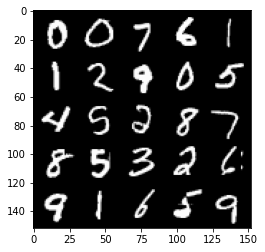

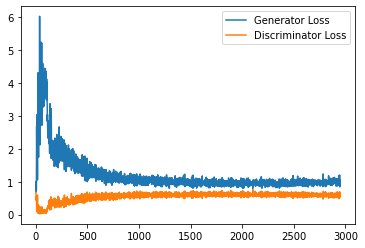

Step 59500: Generator loss: 0.9853536995649338, discriminator loss: 0.5945994665026665


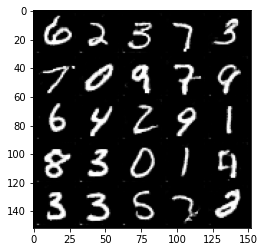

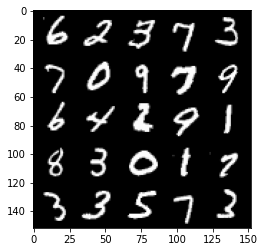

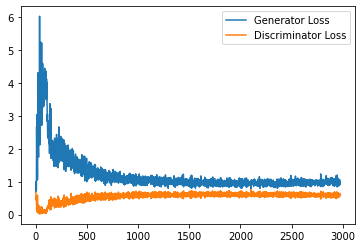

Step 60000: Generator loss: 0.9979369455575943, discriminator loss: 0.5832083387374878


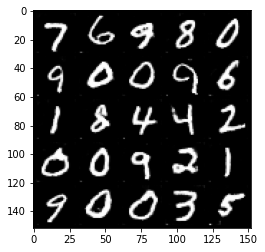

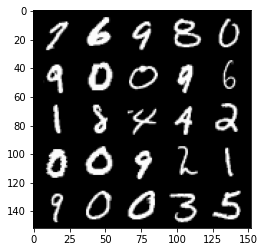

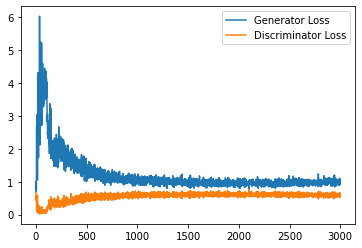

Step 60500: Generator loss: 0.9991881172657013, discriminator loss: 0.590773244202137


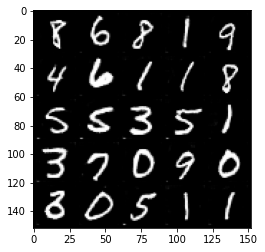

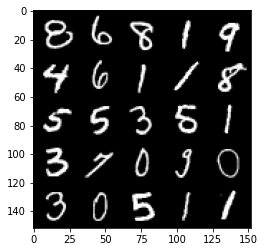

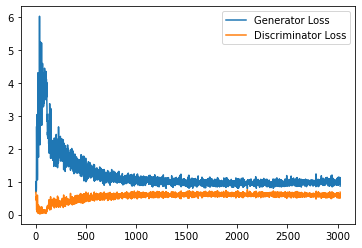

Step 61000: Generator loss: 1.0099571011066437, discriminator loss: 0.5864176639318466


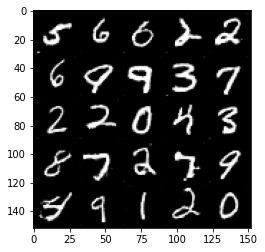

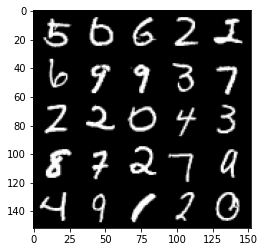

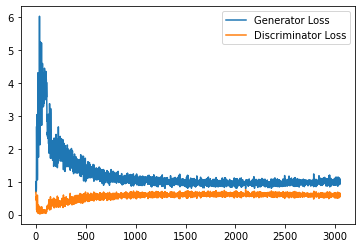

Step 61500: Generator loss: 1.002056398153305, discriminator loss: 0.5868120734095573


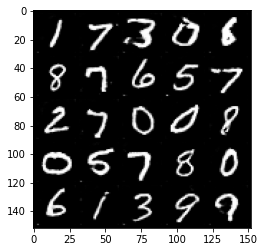

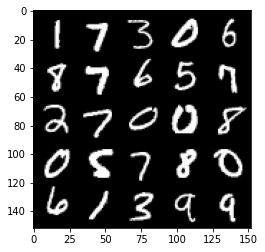

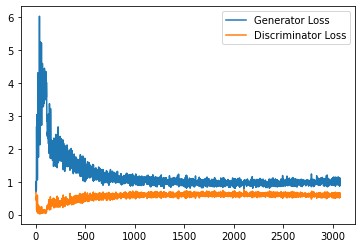

Step 62000: Generator loss: 1.0047337486743928, discriminator loss: 0.5890291391015052


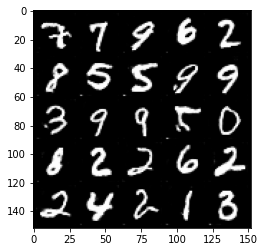

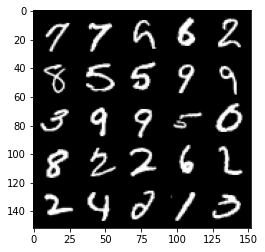

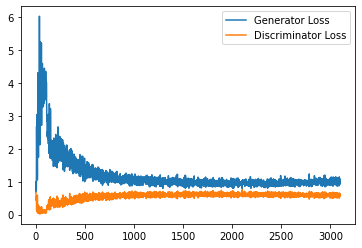

Step 62500: Generator loss: 1.000298105239868, discriminator loss: 0.5874958487153054


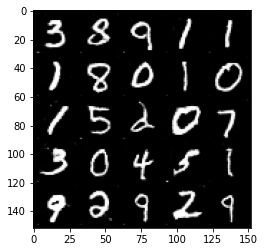

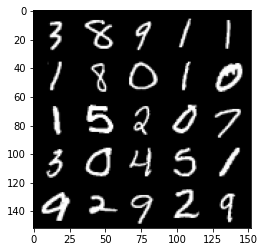

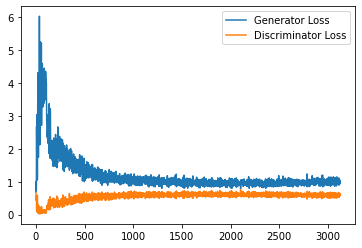

Step 63000: Generator loss: 0.9962958853244781, discriminator loss: 0.5872375173568726


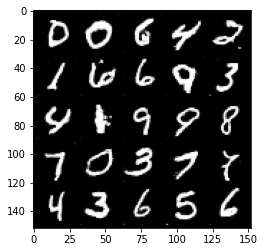

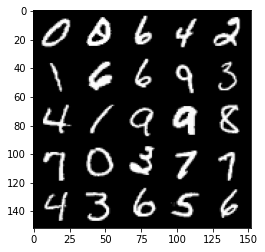

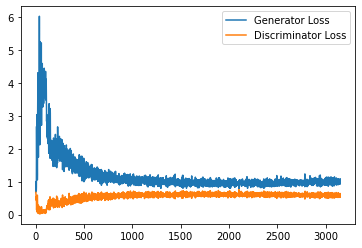

Step 63500: Generator loss: 1.0036773332357407, discriminator loss: 0.5869898634552956


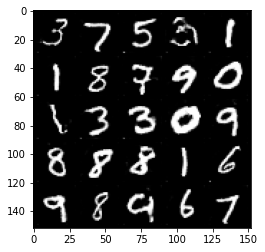

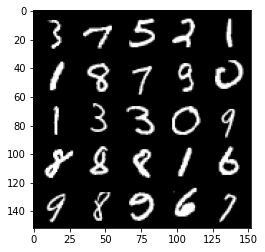

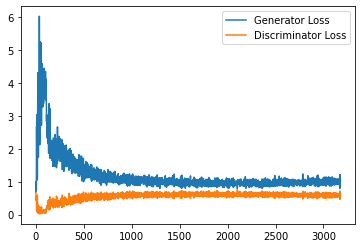

Step 64000: Generator loss: 1.01182861495018, discriminator loss: 0.5799392637014389


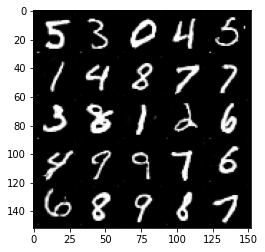

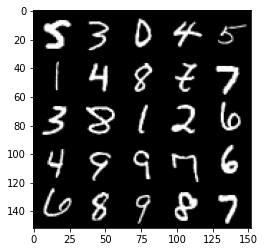

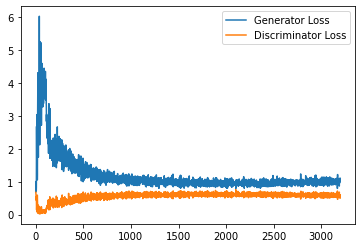

Step 64500: Generator loss: 1.022652416586876, discriminator loss: 0.5876062421798706


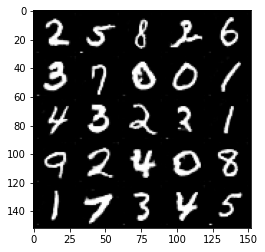

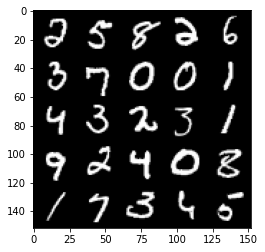

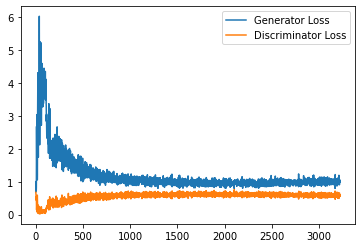

Step 65000: Generator loss: 1.0020334672927858, discriminator loss: 0.5892774822711945


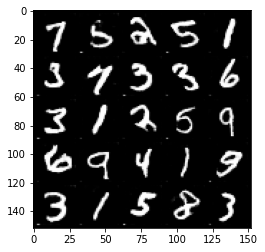

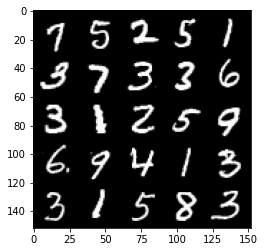

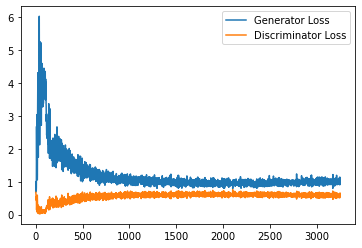

Step 65500: Generator loss: 1.0308618252277375, discriminator loss: 0.5842148072719574


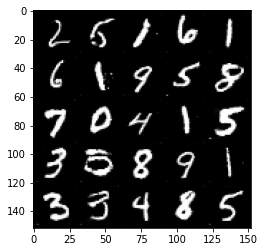

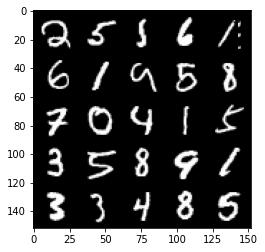

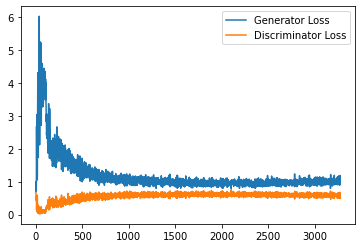

Step 66000: Generator loss: 1.0278568571805955, discriminator loss: 0.5818041061162949


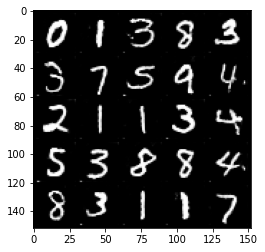

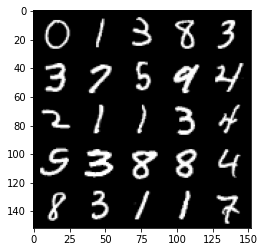

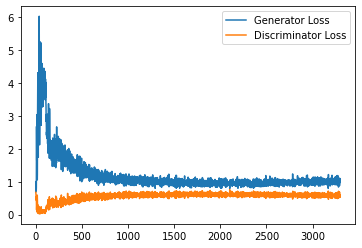

Step 66500: Generator loss: 1.01407679104805, discriminator loss: 0.5849378039240837


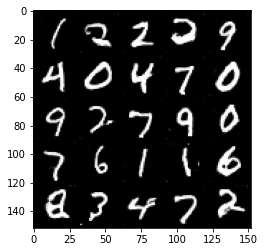

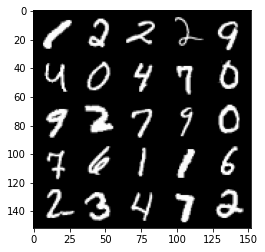

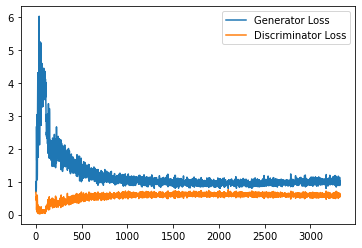

Step 67000: Generator loss: 1.0169552025794983, discriminator loss: 0.5780220329165459


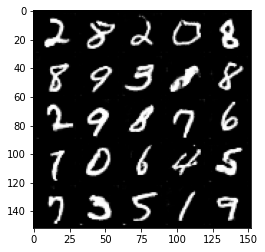

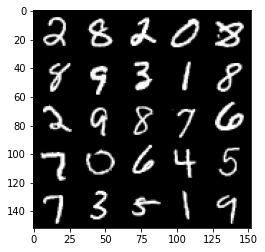

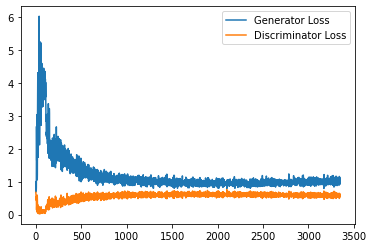

Step 67500: Generator loss: 1.0274477717876433, discriminator loss: 0.5743376609086991


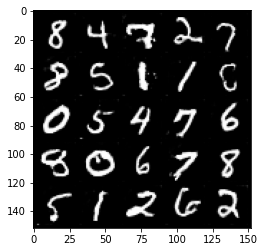

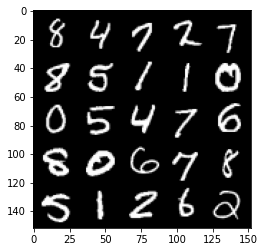

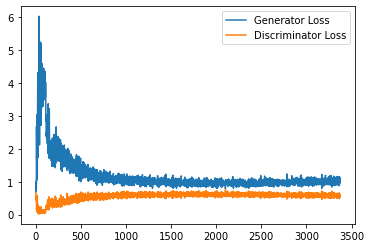

Step 68000: Generator loss: 1.0188727222681047, discriminator loss: 0.5870535223484039


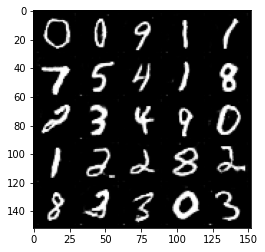

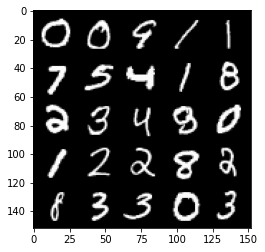

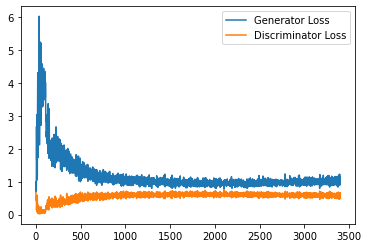

Step 68500: Generator loss: 1.0342075901031493, discriminator loss: 0.577646821141243


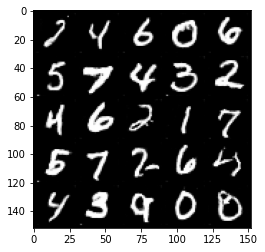

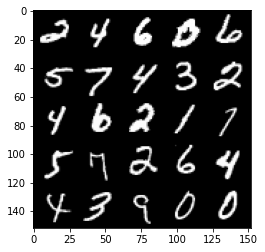

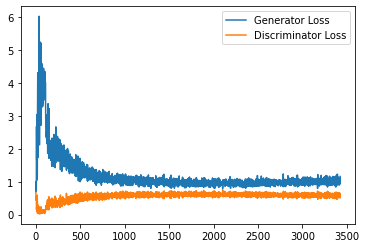

Step 69000: Generator loss: 1.0193078198432923, discriminator loss: 0.5822334216237068


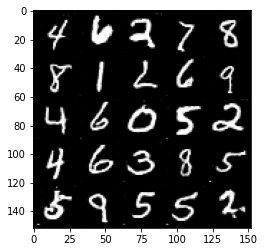

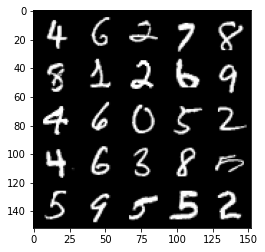

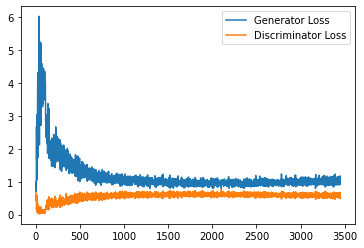

Step 69500: Generator loss: 1.0249819645881653, discriminator loss: 0.5881557769775391


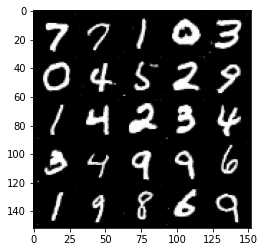

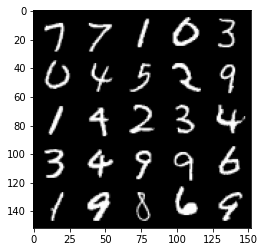

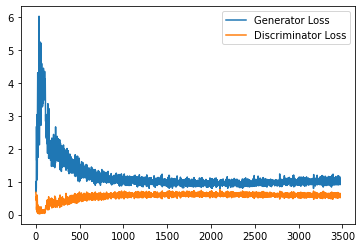

Step 70000: Generator loss: 1.0177607526779175, discriminator loss: 0.5815977102518082


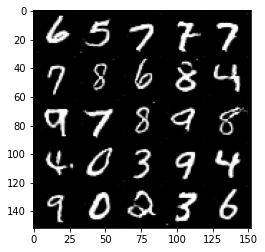

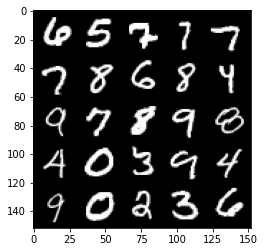

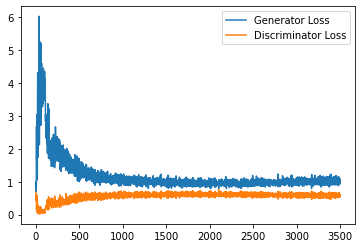

Step 70500: Generator loss: 1.029259569644928, discriminator loss: 0.5807080247402191


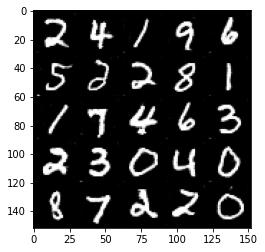

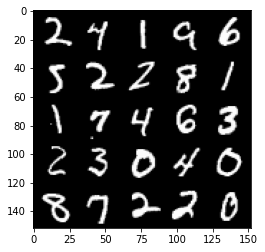

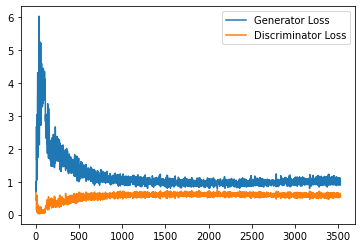

Step 71000: Generator loss: 1.0444920225143433, discriminator loss: 0.5797021822333336


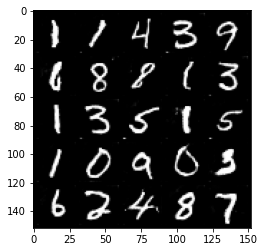

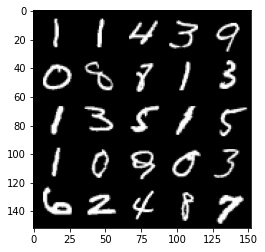

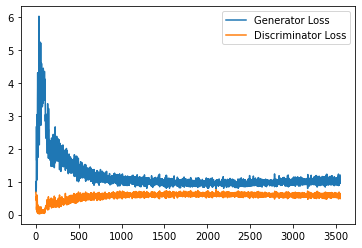

Step 71500: Generator loss: 1.0269697445631027, discriminator loss: 0.5846633126735687


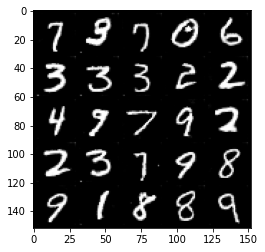

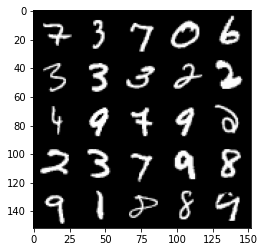

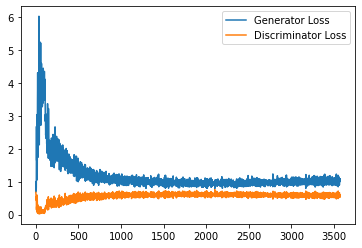

Step 72000: Generator loss: 1.0218488329648971, discriminator loss: 0.5854959558844567


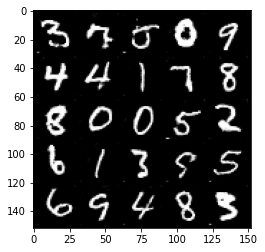

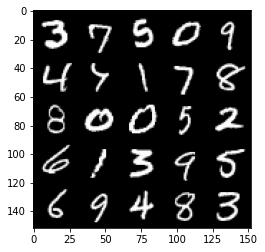

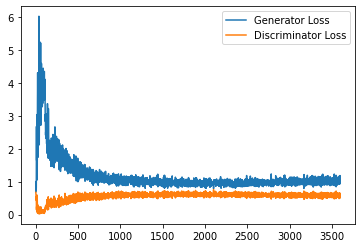

Step 72500: Generator loss: 1.0150524884462357, discriminator loss: 0.5808105303645134


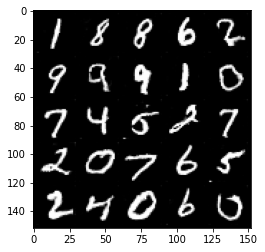

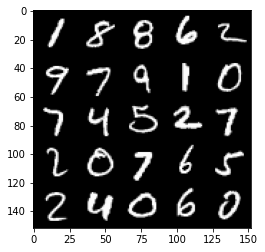

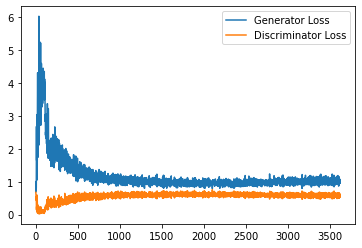

Step 73000: Generator loss: 1.0170579054355622, discriminator loss: 0.5819200183153153


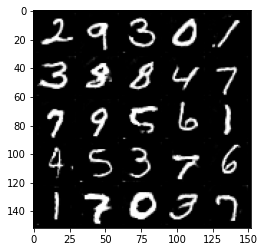

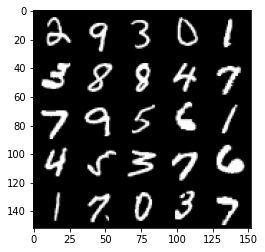

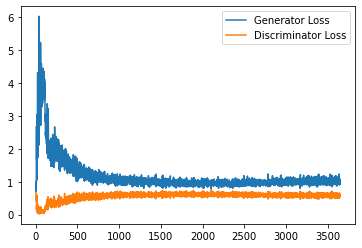

Step 73500: Generator loss: 1.0260544402599334, discriminator loss: 0.5789618995785714


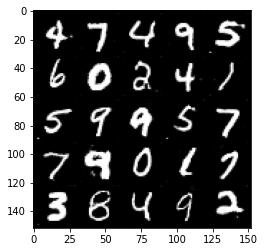

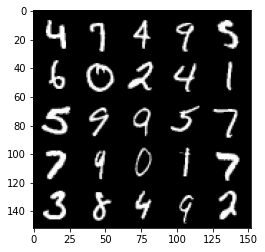

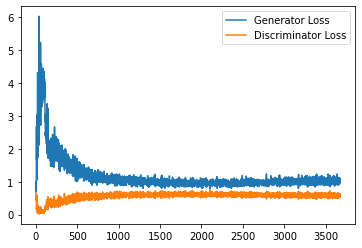

Step 74000: Generator loss: 1.018270954489708, discriminator loss: 0.5854216911792756


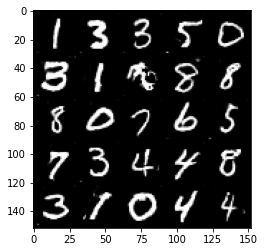

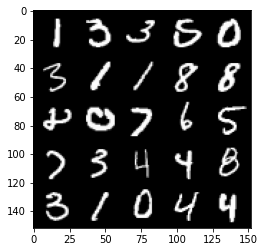

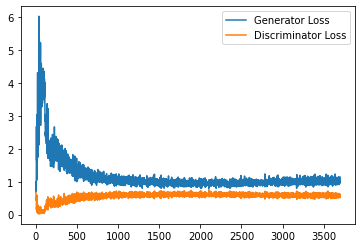

Step 74500: Generator loss: 1.0331111770868302, discriminator loss: 0.5815590530633926


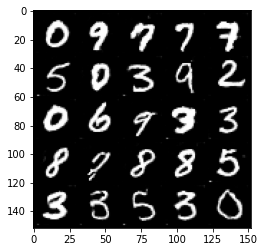

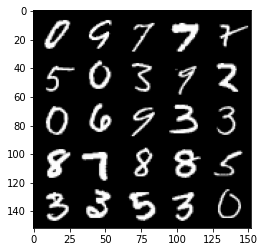

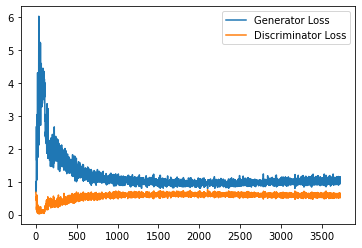

Step 75000: Generator loss: 1.0243775146007539, discriminator loss: 0.5860271645188332


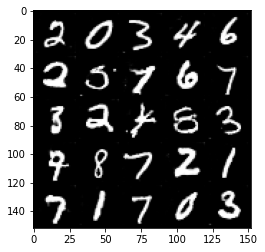

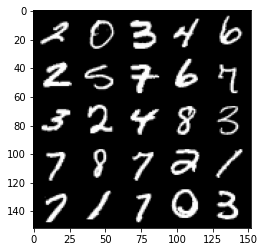

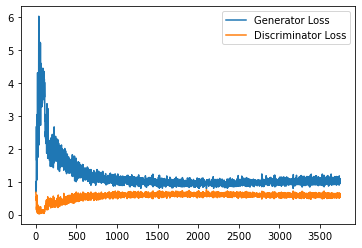

Step 75500: Generator loss: 1.0240586631298065, discriminator loss: 0.5856698542237282


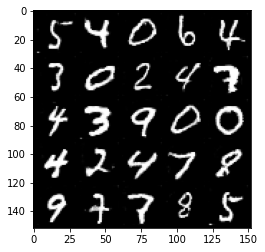

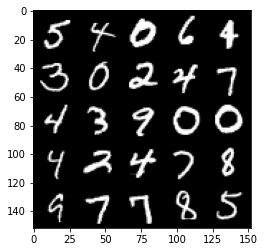

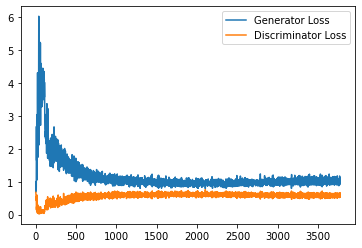

Step 76000: Generator loss: 1.034193443417549, discriminator loss: 0.5798062065243721


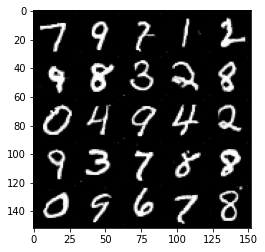

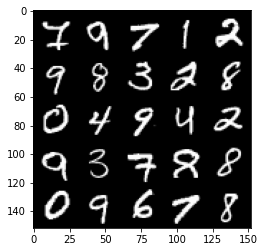

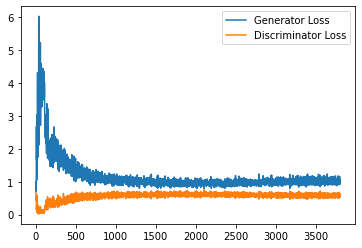

Step 76500: Generator loss: 1.0245157833099365, discriminator loss: 0.5865094727873802


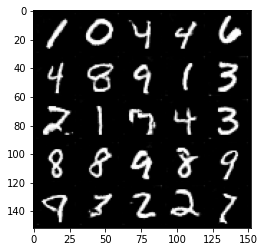

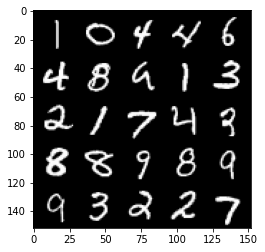

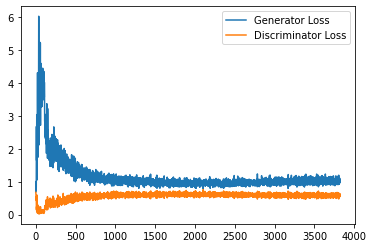

Step 77000: Generator loss: 1.0301233316659928, discriminator loss: 0.5817101157307625


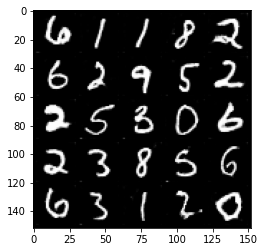

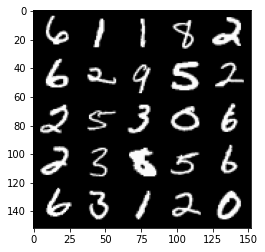

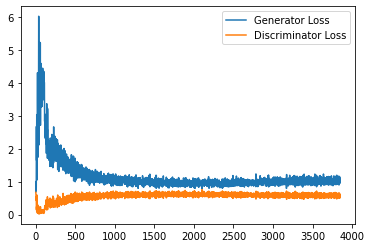

Step 77500: Generator loss: 1.032406953573227, discriminator loss: 0.5776971702575684


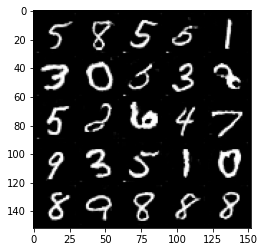

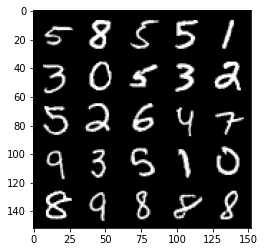

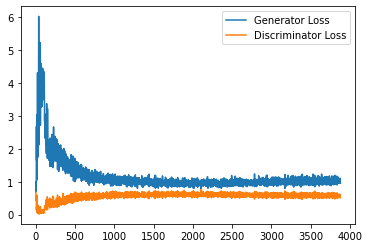

Step 78000: Generator loss: 1.0154712853431702, discriminator loss: 0.5879632019400597


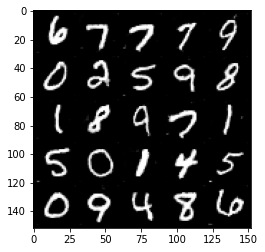

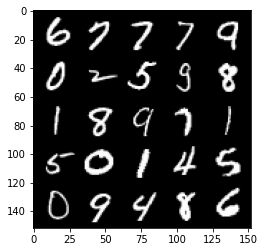

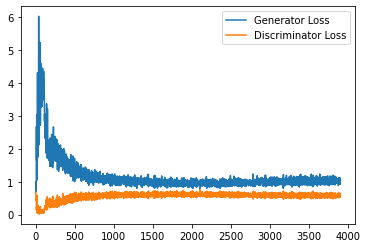

Step 78500: Generator loss: 1.0429291754961014, discriminator loss: 0.5806403968930245


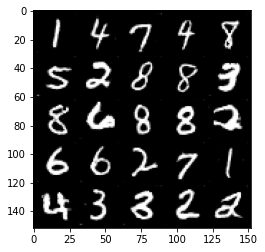

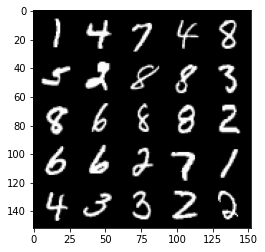

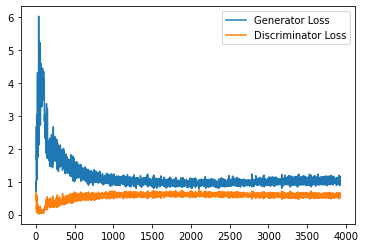

Step 79000: Generator loss: 1.0155402069091797, discriminator loss: 0.5851733303070068


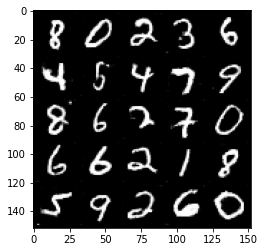

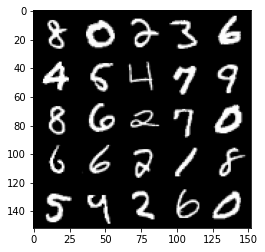

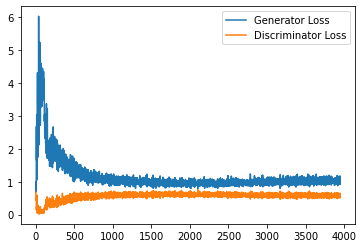

Step 79500: Generator loss: 1.0393732137680054, discriminator loss: 0.5835998440980912


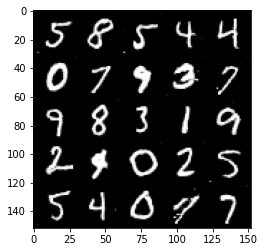

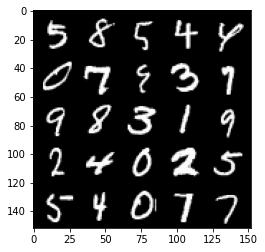

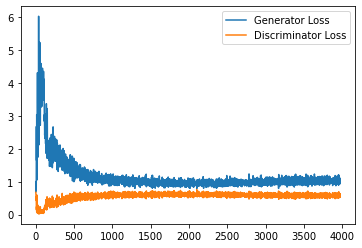

Step 80000: Generator loss: 1.0283621354103087, discriminator loss: 0.5858237059116363


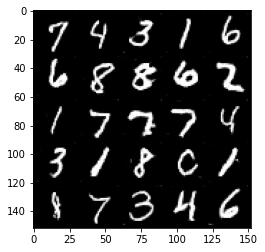

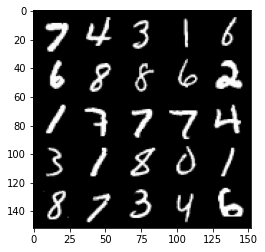

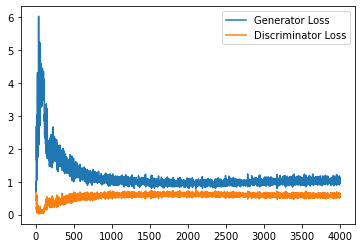

Step 80500: Generator loss: 1.0268686715364457, discriminator loss: 0.5856488999724389


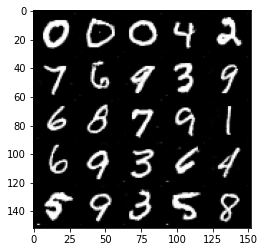

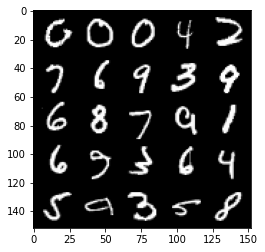

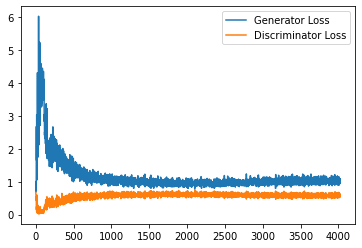

Step 81000: Generator loss: 1.027545022368431, discriminator loss: 0.584383151948452


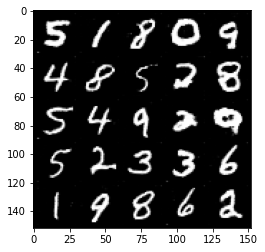

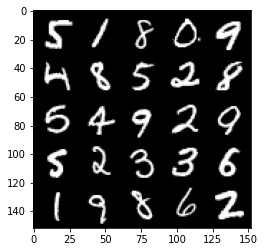

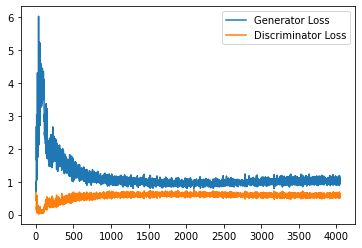

Step 81500: Generator loss: 1.0378613835573196, discriminator loss: 0.582108079135418


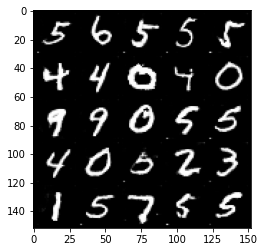

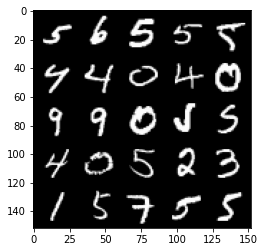

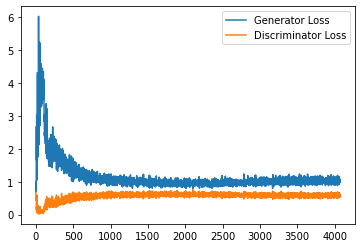

Step 82000: Generator loss: 1.033042114019394, discriminator loss: 0.5827273524999619


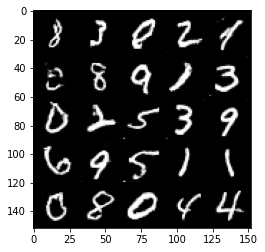

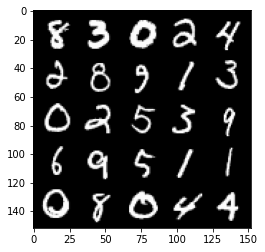

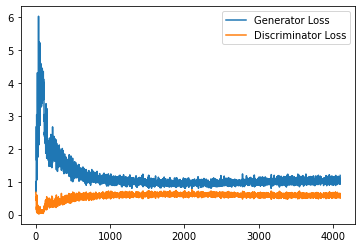

Step 82500: Generator loss: 1.0192158529758453, discriminator loss: 0.5885580694079399


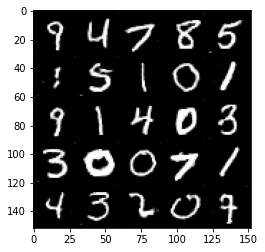

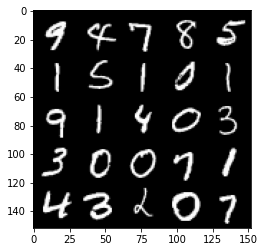

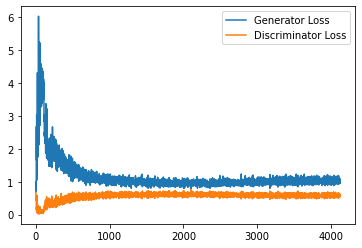

Step 83000: Generator loss: 1.0154986037015914, discriminator loss: 0.5907117431759834


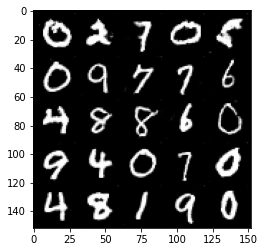

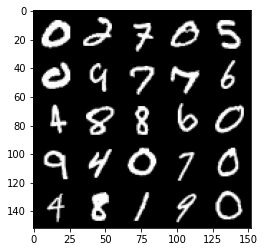

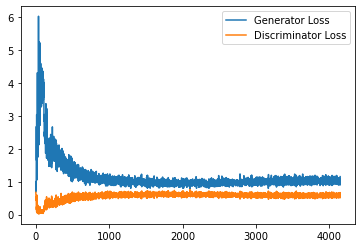

Step 83500: Generator loss: 1.0097119439840316, discriminator loss: 0.592959952890873


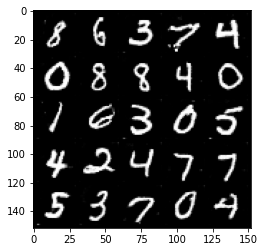

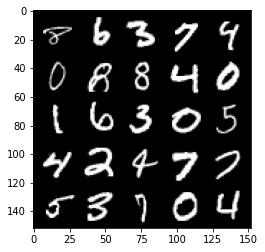

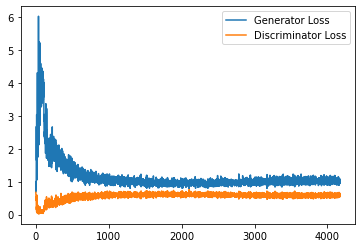

Step 84000: Generator loss: 1.0381630674600602, discriminator loss: 0.5864964279532433


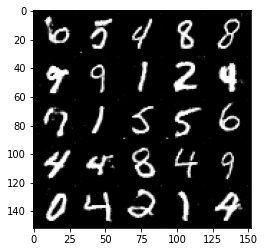

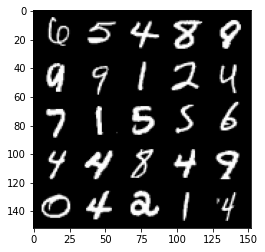

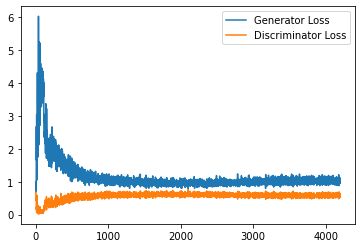

Step 84500: Generator loss: 1.02535642015934, discriminator loss: 0.5884139481782913


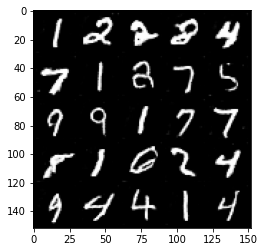

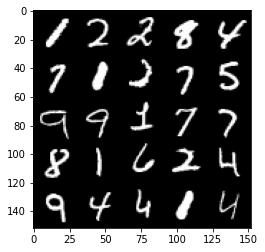

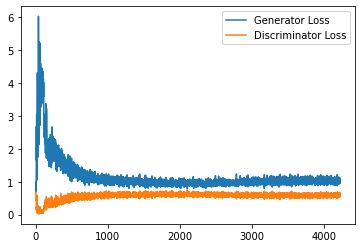

Step 85000: Generator loss: 1.0209695043563842, discriminator loss: 0.5887516672015191


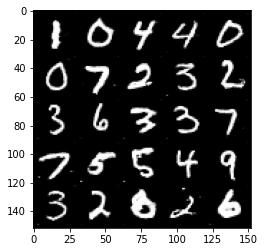

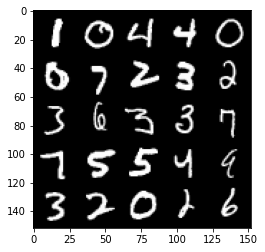

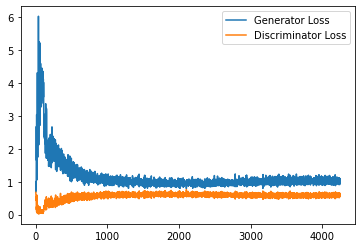

Step 85500: Generator loss: 1.003583235502243, discriminator loss: 0.595285526573658


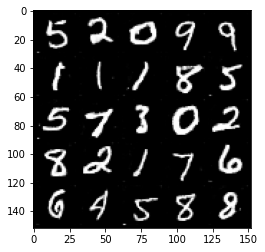

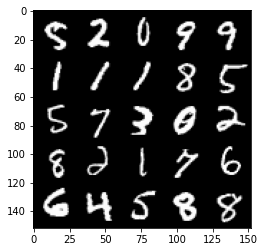

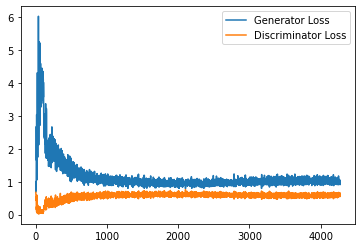

Step 86000: Generator loss: 1.0158342150449753, discriminator loss: 0.5904070810079575


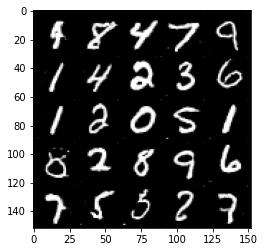

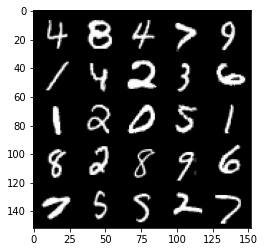

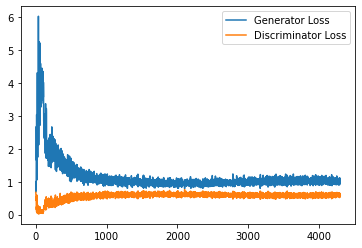

Step 86500: Generator loss: 1.0216509230136872, discriminator loss: 0.5905721052289009


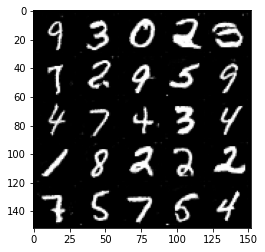

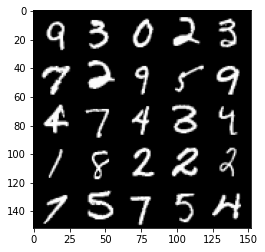

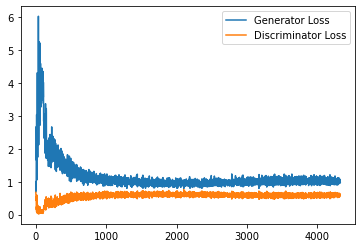

Step 87000: Generator loss: 1.0039507254362106, discriminator loss: 0.5957161566019058


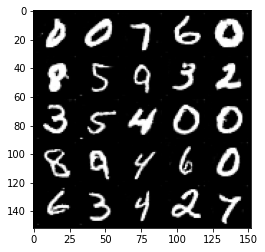

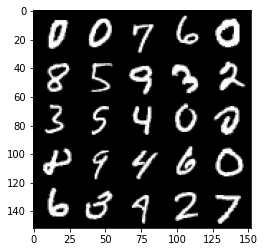

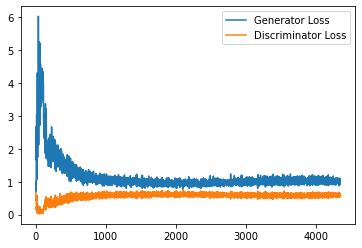

Step 87500: Generator loss: 1.0186687940359116, discriminator loss: 0.5913780483603478


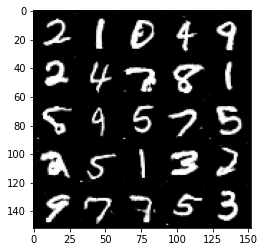

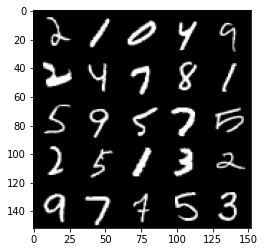

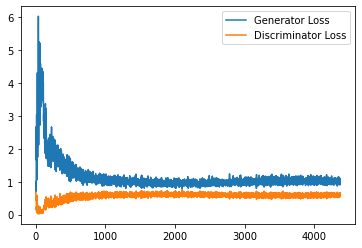

Step 88000: Generator loss: 1.0158095195293426, discriminator loss: 0.5955349721312523


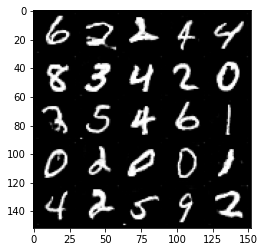

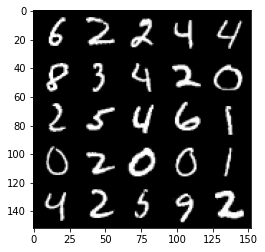

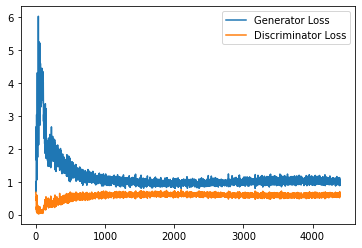

Step 88500: Generator loss: 1.013217585206032, discriminator loss: 0.5939503242373466


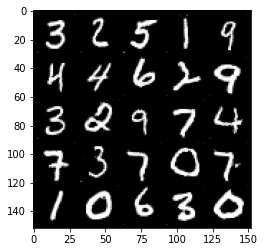

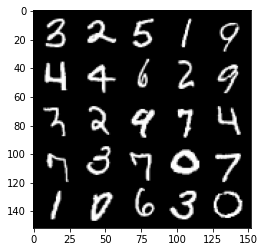

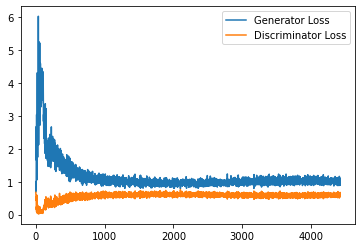

Step 89000: Generator loss: 1.0193556505441665, discriminator loss: 0.5960238570570946


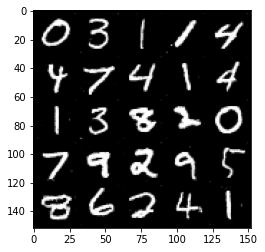

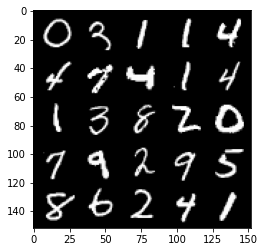

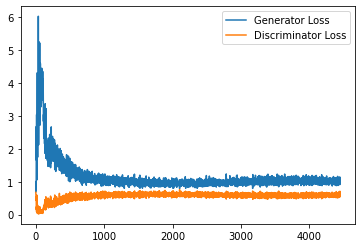

Step 89500: Generator loss: 0.9926600899696351, discriminator loss: 0.5997119391560555


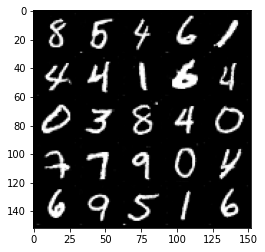

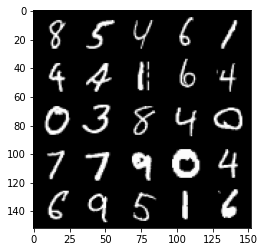

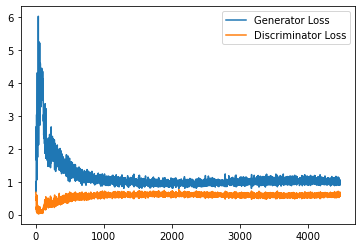

Step 90000: Generator loss: 0.9998161413669586, discriminator loss: 0.6011935935616494


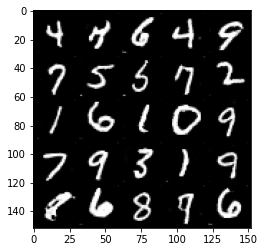

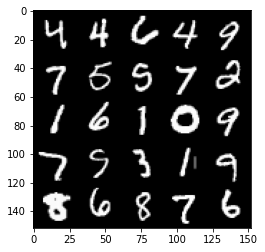

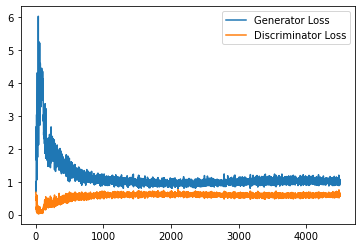

Step 90500: Generator loss: 0.9969831902980805, discriminator loss: 0.5986194534897804


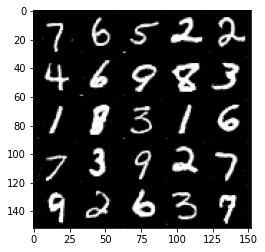

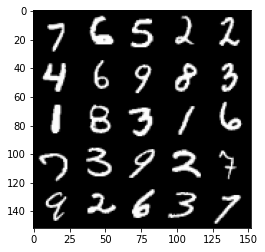

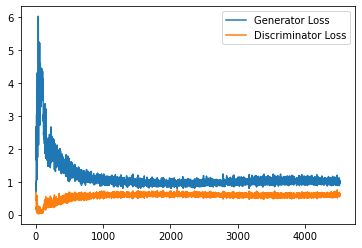

Step 91000: Generator loss: 1.0039938993453978, discriminator loss: 0.6009672100543976


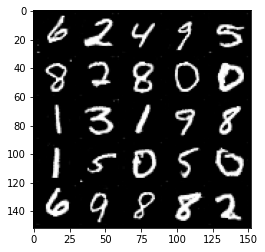

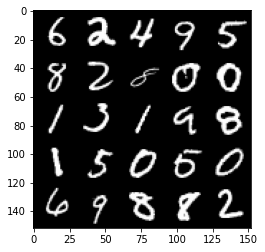

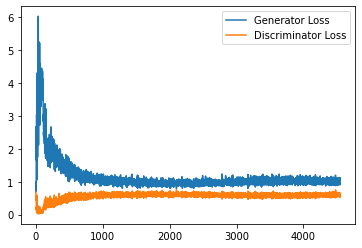

Step 91500: Generator loss: 0.9975066159963608, discriminator loss: 0.6026691406369209


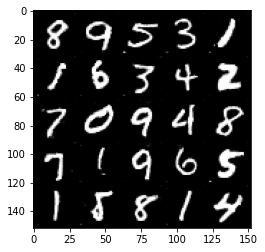

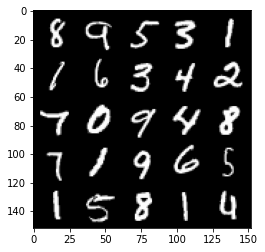

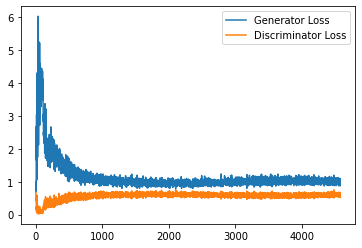

Step 92000: Generator loss: 0.9884089199304581, discriminator loss: 0.5988209816217422


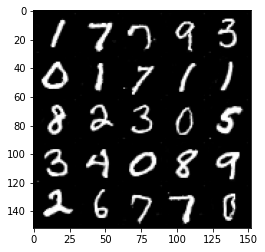

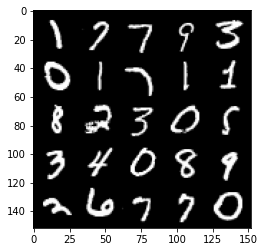

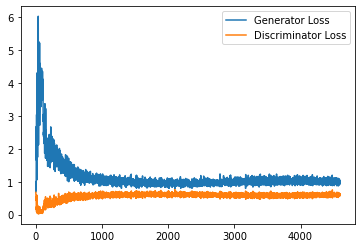

Step 92500: Generator loss: 1.012382612466812, discriminator loss: 0.5983905382156373


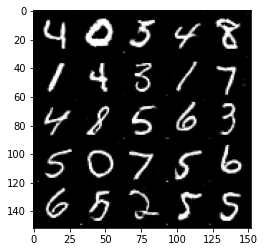

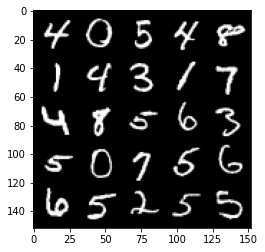

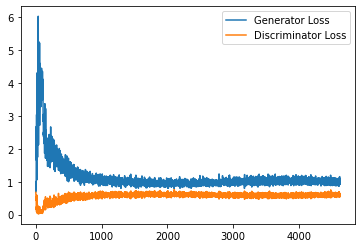

Step 93000: Generator loss: 1.0071939138174058, discriminator loss: 0.6048375399708747


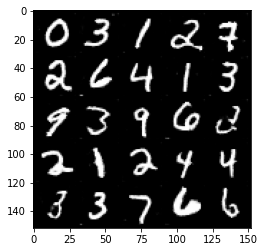

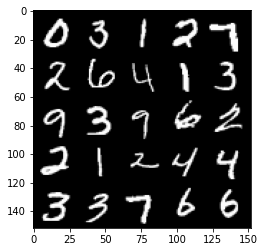

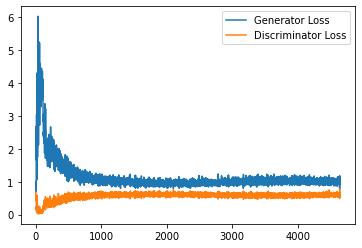

Step 93500: Generator loss: 0.9830779340267182, discriminator loss: 0.6044997745156289


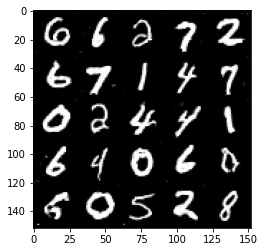

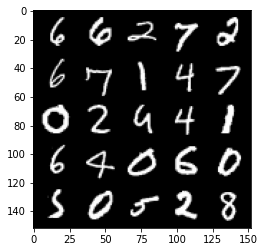

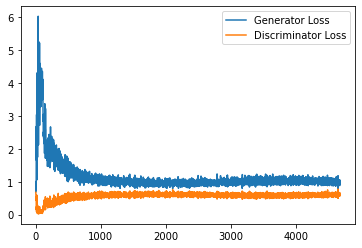

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [16]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

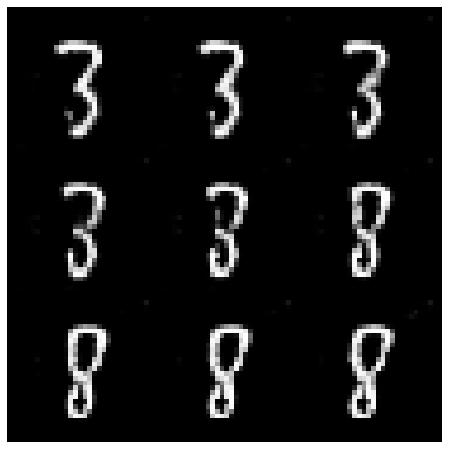

In [17]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 3 # Choose the start digit
### Change me! ###
end_plot_number = 8 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

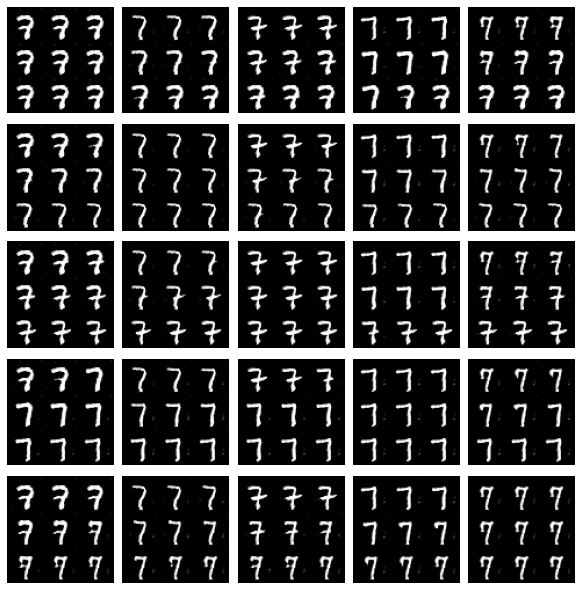

In [20]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([7]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()